In [2]:
import cv2
import os
import functions
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter
import seg_and_classify
from sklearn.linear_model import LinearRegression

In [3]:
path = 'Bananas time dataset'
#path = 'bananas_time_dataset_nuno'
imagens_time = []
for folder_path, folders, files in os.walk(path):
    print(files)

imagens_time = []
for i in range(len(files)):
    imagens_time.append(path+"/"+str(files[i]))

print(imagens_time)

['t0_0 (3).jpg', 't0_0 (6).jpg', 't0_0 (7).jpg', 't0_124 (2).jpg', 't0_124 (3).jpg', 't0_146 (1).jpg', 't0_146 (2).jpg', 't0_146 (3).jpg', 't0_146 (4).jpg', 't0_167 (1).jpg', 't0_167 (2).jpg', 't0_193 (1).jpg', 't0_193 (2).jpg', 't0_217 (2).jpg', 't0_217 (3).jpg', 't0_24 (2).jpg', 't0_24 (3).jpg', 't0_24 (4).jpg', 't0_24 (5).jpg', 't0_24 (6).jpg', 't0_241 (1).jpg', 't0_241 (2).jpg', 't0_48 (1).jpg', 't0_48 (2).jpg', 't0_48 (3).jpg', 't0_48 (4).jpg', 't0_70 (1).jpg', 't0_70 (3).jpg', 't0_70 (4).jpg', 't0_97 (1).jpg', 't0_97 (3).jpg', 't0_97 (4).jpg', 't1_0 (4).jpg', 't1_124 (1).jpg', 't1_124 (2).jpg', 't1_146 (1).jpg', 't1_146 (2).jpg', 't1_167 (1).jpg', 't1_167 (2).jpg', 't1_193 (1).jpg', 't1_193 (2).jpg', 't1_217 (2).jpg', 't1_217 (3).jpg', 't1_24 (1).jpg', 't1_24 (3).jpg', 't1_24 (4).jpg', 't1_241 (1).jpg', 't1_241 (2).jpg', 't1_48 (1).jpg', 't1_48 (2).jpg', 't1_48 (3).jpg', 't1_48 (4).jpg', 't1_70 (1).jpg', 't1_70 (3).jpg', 't1_97 (2).jpg', 't1_97 (3).jpg', 't2_0 (1).jpg', 't2_0 (2)

In [4]:
def get_hours(files):
    hours = np.zeros(len(files))
    for i in range(len(files)):
        res1 = files[i].split('_')[1]
        hours[i] = int(res1.split(' ')[0])
        #print(files[i], res2)
    return hours

In [5]:
def plot_regression_line(x, y, b):
    # plotting the actual points as scatter plot
    plt.scatter(x, y, color = "m",
               marker = "o", s = 30)
 
    # predicted response vector
    y_pred = b[0] + b[1]*x
 
    # plotting the regression line
    plt.plot(x, y_pred, color = "g")
 
    # putting labels
    plt.xlabel('x')
    plt.ylabel('y')
 
    # function to show plot
    plt.show()

In [11]:
def time_analysis(files, start_index, end_index):
    size = end_index - start_index
    outputs = np.zeros(size)
    hh = get_hours(files[start_index:end_index])
    for i in range(size):
        outputs[i]=seg_and_classify.seg_n_class(plt.imread(imagens_time[i+start_index]))
        print((i+1)/size * 100, "%")
        print("file and hours", imagens_time[i+start_index], hh[i])
    

    #check for NaN's:
    if(np.isnan(outputs).any()):
        print("The Array contains NaN values")

    nans = []
    for i in range(size):
        if np.isnan(outputs[i]) == True:
            nans.append(i)
    print("NaNs=", nans)

    x = np.delete(hh, np.where(np.isnan(outputs[i]) == True))
    y = np.delete(outputs, np.where(np.isnan(outputs[i]) == True))

    print(outputs, x, y)

    reg = LinearRegression().fit(x.reshape(-1, 1), y.reshape(-1, 1))

    print("Regression parameters: b=", reg.intercept_, " m=", reg.coef_, reg.score(hh.reshape(-1, 1), outputs.reshape(-1, 1)))

    plot_regression_line(hh.reshape(-1, 1), outputs.reshape(-1, 1), [reg.intercept_, reg.coef_])
    return x.reshape(-1, 1), y.reshape(-1, 1)

In [12]:
def get_indexes(files):
    bananas = []
    for i in range(len(files)):
        bananas.append(files[i].split('_')[0])
    keys = list(Counter(bananas).keys())
    values = list(Counter(bananas).values())
    end_index=np.cumsum(np.array(values))
    start_index=np.zeros(end_index.shape[0])
    for i in range(1, end_index.shape[0], 1):
        start_index[i]=end_index[i-1]
    return keys, start_index.astype(int), end_index.astype(int)

In [13]:
keys, start_index, end_index = get_indexes(files)
print(keys, start_index, end_index)

['t0', 't1', 't2', 't3', 't4', 't5', 't6'] [  0  32  56  85 111 138 169] [ 32  56  85 111 138 169 200]


In [9]:
print(files[start_index[0]: end_index[0]])

['t0_0 (3).jpg', 't0_0 (6).jpg', 't0_0 (7).jpg', 't0_124 (2).jpg', 't0_124 (3).jpg', 't0_146 (1).jpg', 't0_146 (2).jpg', 't0_146 (3).jpg', 't0_146 (4).jpg', 't0_167 (1).jpg', 't0_167 (2).jpg', 't0_193 (1).jpg', 't0_193 (2).jpg', 't0_217 (2).jpg', 't0_217 (3).jpg', 't0_24 (2).jpg', 't0_24 (3).jpg', 't0_24 (4).jpg', 't0_24 (5).jpg', 't0_24 (6).jpg', 't0_241 (1).jpg', 't0_241 (2).jpg', 't0_48 (1).jpg', 't0_48 (2).jpg', 't0_48 (3).jpg', 't0_48 (4).jpg', 't0_70 (1).jpg', 't0_70 (3).jpg', 't0_70 (4).jpg', 't0_97 (1).jpg', 't0_97 (3).jpg', 't0_97 (4).jpg']



0: 480x640 1 person, 1 bowl, 1 banana, 2902.3ms
Speed: 19.8ms preprocess, 2902.3ms inference, 15.8ms postprocess per image at shape (1, 3, 640, 640)


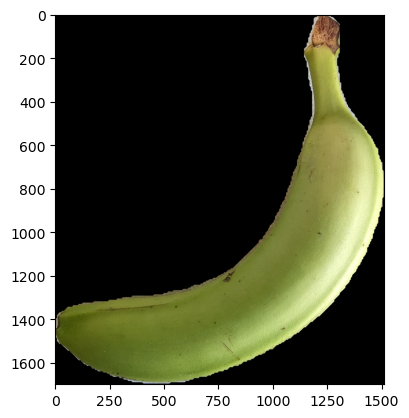

1/1 [==============================] - 0s 15ms/step
[    0.99825  1.0115e-06  0.00054767   0.0012009]
0.004698958191966085
3.125 %
file and hours Bananas time dataset/t0_0 (3).jpg 0.0



0: 480x640 1 person, 1 bowl, 1 banana, 1 dining table, 1 cell phone, 1 microwave, 2460.8ms
Speed: 2.1ms preprocess, 2460.8ms inference, 5.1ms postprocess per image at shape (1, 3, 640, 640)


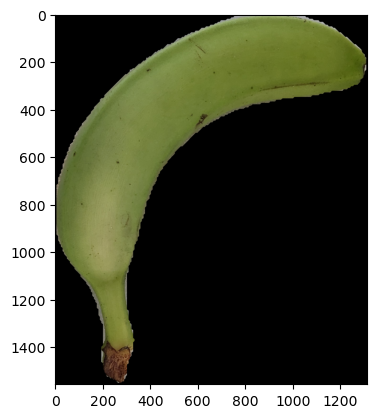

1/1 [==============================] - 0s 33ms/step
[    0.73253   0.0003722    0.055774     0.21132]
0.7458769040822517
6.25 %
file and hours Bananas time dataset/t0_0 (6).jpg 0.0



0: 480x640 1 person, 1 bowl, 1 banana, 1 cell phone, 1 microwave, 2621.8ms
Speed: 19.8ms preprocess, 2621.8ms inference, 28.0ms postprocess per image at shape (1, 3, 640, 640)


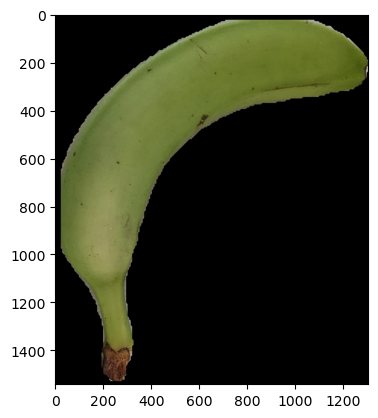

1/1 [==============================] - 0s 30ms/step
[    0.69974  0.00045144    0.054121     0.24569]
0.8457575541397091
9.375 %
file and hours Bananas time dataset/t0_0 (7).jpg 0.0



0: 480x640 1 knife, 1 banana, 2668.5ms
Speed: 0.0ms preprocess, 2668.5ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


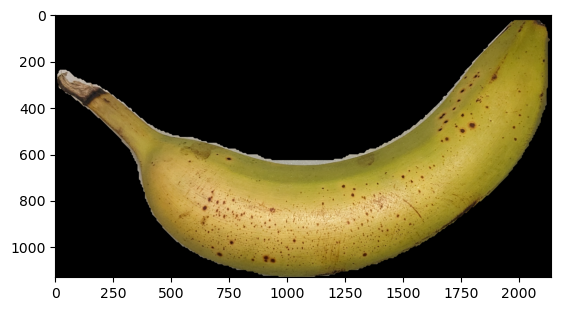

1/1 [==============================] - 0s 29ms/step
[ 8.9209e-05    0.003525  2.7442e-12     0.99639]
2.992682480025937
12.5 %
file and hours Bananas time dataset/t0_124 (2).jpg 124.0



0: 480x640 1 banana, 2601.9ms
Speed: 0.0ms preprocess, 2601.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


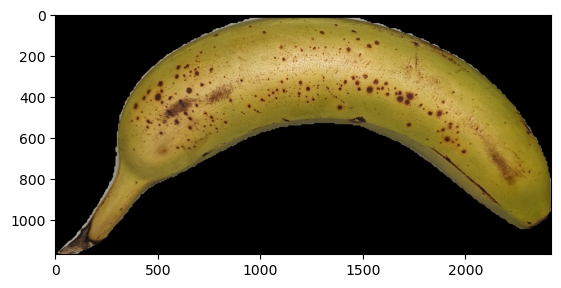

1/1 [==============================] - 0s 29ms/step


[  1.302e-06     0.60284  4.4528e-10     0.39716]
1.7943173059785955
15.625 %
file and hours Bananas time dataset/t0_124 (3).jpg 124.0


0: 640x480 1 banana, 2602.6ms
Speed: 15.7ms preprocess, 2602.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


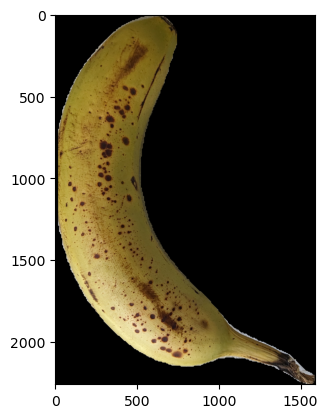

1/1 [==============================] - 0s 31ms/step
[ 0.00012235     0.72212  0.00023465     0.27752]
1.555158402537927
18.75 %
file and hours Bananas time dataset/t0_146 (1).jpg 146.0



0: 640x480 1 kite, 1 banana, 2881.6ms
Speed: 17.7ms preprocess, 2881.6ms inference, 14.1ms postprocess per image at shape (1, 3, 640, 640)


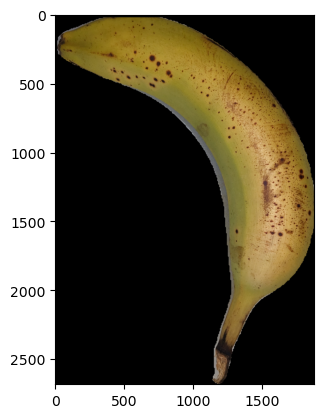

1/1 [==============================] - 0s 32ms/step
[     0.3595     0.50769   0.0088176       0.124]
0.897317236289382
21.875 %
file and hours Bananas time dataset/t0_146 (2).jpg 146.0



0: 640x480 1 banana, 3003.2ms
Speed: 5.0ms preprocess, 3003.2ms inference, 15.6ms postprocess per image at shape (1, 3, 640, 640)


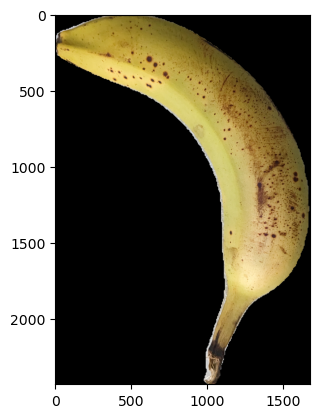

1/1 [==============================] - 0s 31ms/step
[    0.51205    0.073487   0.0040462     0.41042]
1.3128340495750308
25.0 %
file and hours Bananas time dataset/t0_146 (3).jpg 146.0



0: 640x480 1 banana, 2909.0ms
Speed: 3.0ms preprocess, 2909.0ms inference, 9.1ms postprocess per image at shape (1, 3, 640, 640)


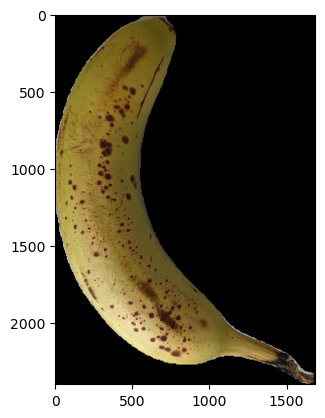

1/1 [==============================] - 0s 30ms/step
[   0.000144     0.69822  0.00034164      0.3013]
1.6027880255132914
28.125 %
file and hours Bananas time dataset/t0_146 (4).jpg 146.0



0: 480x640 1 banana, 2884.7ms
Speed: 0.0ms preprocess, 2884.7ms inference, 27.6ms postprocess per image at shape (1, 3, 640, 640)


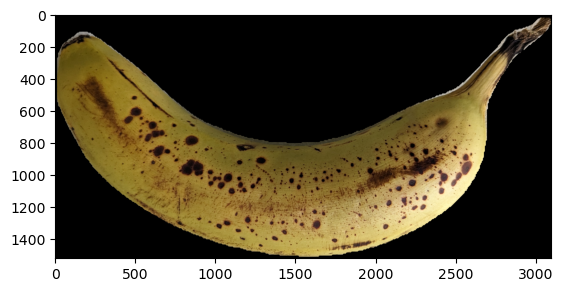

1/1 [==============================] - 0s 31ms/step
[ 0.00023998      0.5705  4.9722e-05     0.42921]
1.8582363368186634
31.25 %
file and hours Bananas time dataset/t0_167 (1).jpg 167.0



0: 480x640 1 banana, 3035.1ms
Speed: 3.1ms preprocess, 3035.1ms inference, 28.9ms postprocess per image at shape (1, 3, 640, 640)


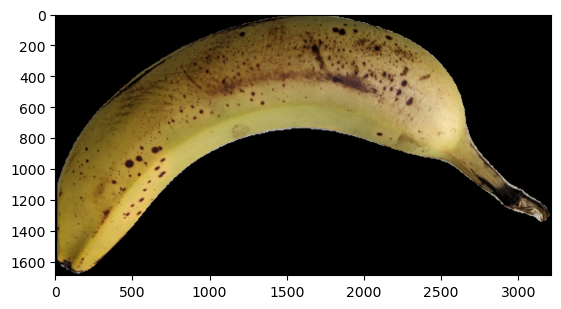

1/1 [==============================] - 0s 32ms/step
[ 9.2238e-05     0.27724   1.508e-07     0.72267]
2.4452386832310538
34.375 %
file and hours Bananas time dataset/t0_167 (2).jpg 167.0



0: 480x640 1 knife, 1 banana, 3107.3ms
Speed: 4.0ms preprocess, 3107.3ms inference, 16.2ms postprocess per image at shape (1, 3, 640, 640)


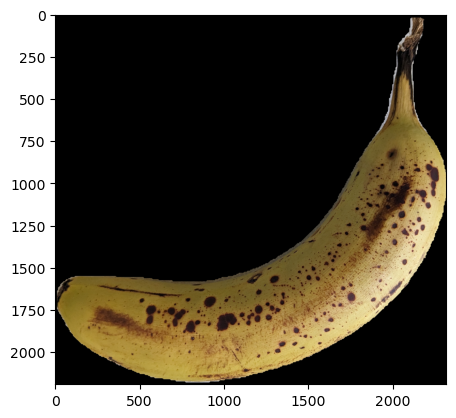

1/1 [==============================] - 0s 55ms/step
[  0.0030147     0.70311    0.049315     0.24456]
1.535412721335888
37.5 %
file and hours Bananas time dataset/t0_193 (1).jpg 193.0



0: 480x640 1 banana, 3154.2ms
Speed: 7.0ms preprocess, 3154.2ms inference, 15.1ms postprocess per image at shape (1, 3, 640, 640)


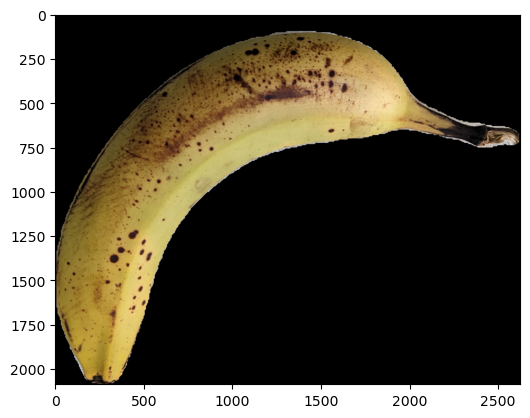

1/1 [==============================] - 0s 34ms/step
[  0.0008766      0.1863  0.00067613     0.81215]
2.6241016500862315
40.625 %
file and hours Bananas time dataset/t0_193 (2).jpg 193.0



0: 480x640 1 banana, 3310.1ms
Speed: 1.3ms preprocess, 3310.1ms inference, 34.0ms postprocess per image at shape (1, 3, 640, 640)


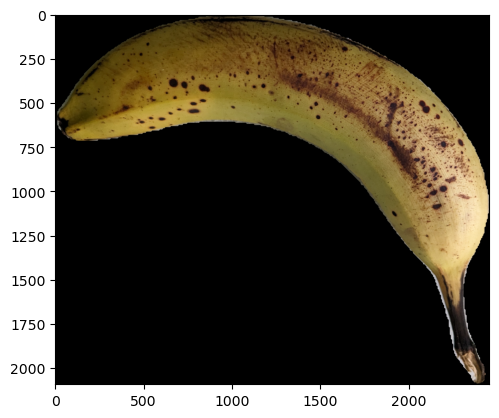

1/1 [==============================] - 0s 55ms/step
[ 0.00029035      0.8379     0.13826    0.023551]
1.1850674375891685
43.75 %
file and hours Bananas time dataset/t0_217 (2).jpg 217.0



0: 640x480 1 cup, 1 banana, 3614.8ms
Speed: 20.9ms preprocess, 3614.8ms inference, 17.9ms postprocess per image at shape (1, 3, 640, 640)


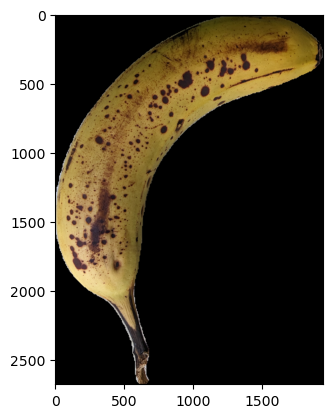

1/1 [==============================] - 0s 28ms/step
[ 5.8363e-06  5.1592e-05     0.99994   5.977e-07]
1.9999372757187643
46.875 %
file and hours Bananas time dataset/t0_217 (3).jpg 217.0



0: 640x480 1 banana, 3198.6ms
Speed: 6.7ms preprocess, 3198.6ms inference, 7.1ms postprocess per image at shape (1, 3, 640, 640)


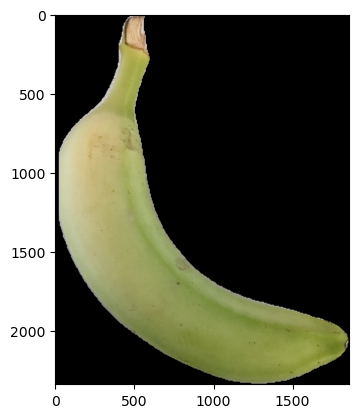

1/1 [==============================] - 0s 36ms/step
[          1  9.1344e-10  1.0667e-07  3.5674e-09]
2.2495019846857645e-07
50.0 %
file and hours Bananas time dataset/t0_24 (2).jpg 24.0



0: 480x640 1 knife, 1 banana, 3442.9ms
Speed: 5.0ms preprocess, 3442.9ms inference, 22.0ms postprocess per image at shape (1, 3, 640, 640)


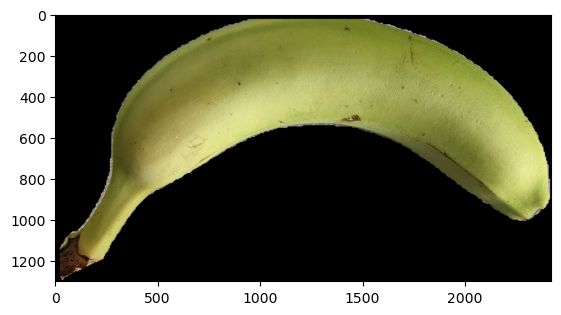

1/1 [==============================] - 0s 33ms/step
[    0.98531  9.2646e-08  4.6487e-09    0.014692]
0.044075141159140685
53.125 %
file and hours Bananas time dataset/t0_24 (3).jpg 24.0



0: 640x480 1 banana, 3724.4ms
Speed: 6.0ms preprocess, 3724.4ms inference, 31.4ms postprocess per image at shape (1, 3, 640, 640)


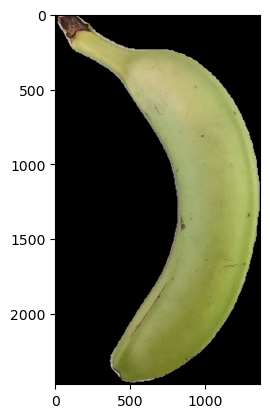

1/1 [==============================] - 0s 27ms/step
[          1  1.0631e-16  1.4967e-07  1.9053e-13]
2.993396070381882e-07
56.25 %
file and hours Bananas time dataset/t0_24 (4).jpg 24.0



0: 480x640 1 knife, 1 banana, 3066.1ms
Speed: 5.0ms preprocess, 3066.1ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


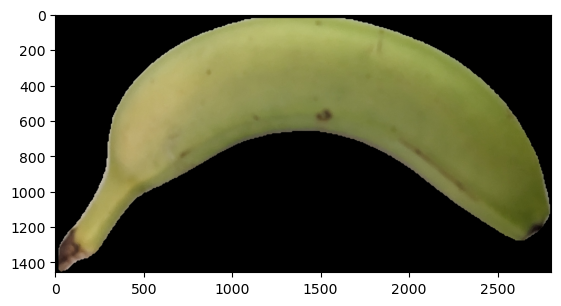

1/1 [==============================] - 0s 34ms/step
[    0.98157  2.0667e-08  6.6964e-10     0.01843]
0.055290257212463056
59.375 %
file and hours Bananas time dataset/t0_24 (5).jpg 24.0



0: 480x640 1 knife, 1 banana, 3092.7ms
Speed: 5.0ms preprocess, 3092.7ms inference, 26.6ms postprocess per image at shape (1, 3, 640, 640)


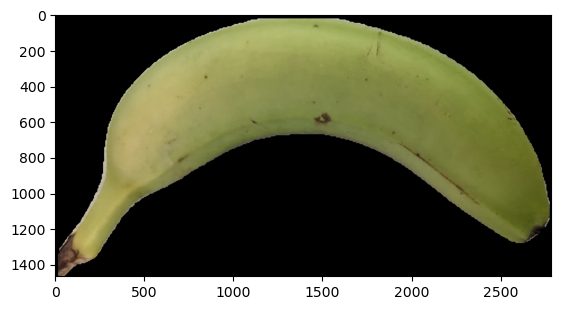

1/1 [==============================] - 0s 31ms/step
[    0.98828  5.4324e-09  2.1373e-10    0.011723]
0.03516984013095731
62.5 %
file and hours Bananas time dataset/t0_24 (6).jpg 24.0



0: 640x480 1 person, 1 traffic light, 1 banana, 3111.9ms
Speed: 5.0ms preprocess, 3111.9ms inference, 14.5ms postprocess per image at shape (1, 3, 640, 640)


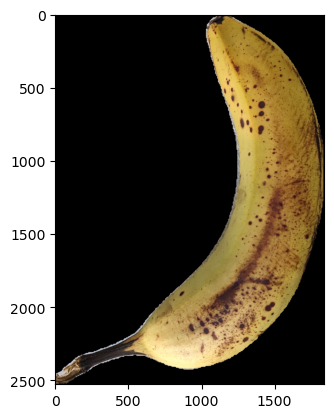

1/1 [==============================] - 0s 20ms/step
[ 0.00030296     0.84732    0.031523     0.12086]
1.2729356586933136
65.625 %
file and hours Bananas time dataset/t0_241 (1).jpg 241.0



0: 640x480 1 traffic light, 1 banana, 3094.5ms
Speed: 15.6ms preprocess, 3094.5ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


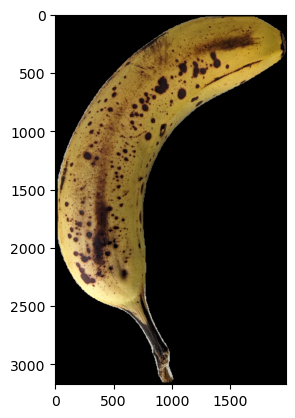

1/1 [==============================] - 0s 29ms/step
[  8.995e-06   0.0059803     0.99399   2.379e-05]
1.9940254087614449
68.75 %
file and hours Bananas time dataset/t0_241 (2).jpg 241.0



0: 640x480 1 banana, 3277.8ms
Speed: 0.0ms preprocess, 3277.8ms inference, 34.0ms postprocess per image at shape (1, 3, 640, 640)


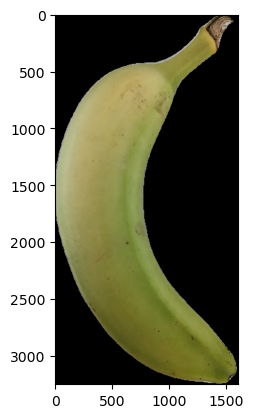

1/1 [==============================] - 0s 41ms/step
[    0.99621  2.8224e-09  1.4309e-12   0.0037878]
0.011363272120757967
71.875 %
file and hours Bananas time dataset/t0_48 (1).jpg 48.0



0: 640x480 1 banana, 3473.9ms
Speed: 0.0ms preprocess, 3473.9ms inference, 40.0ms postprocess per image at shape (1, 3, 640, 640)


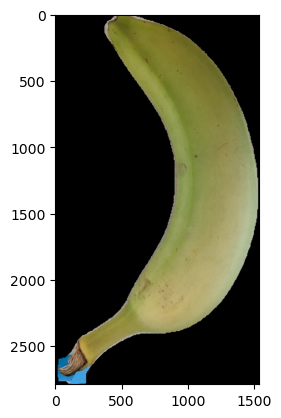

1/1 [==============================] - 0s 39ms/step
[          1  3.4874e-11  4.5851e-08  2.1097e-07]
7.246376876567096e-07
75.0 %
file and hours Bananas time dataset/t0_48 (2).jpg 48.0



0: 640x480 1 banana, 4908.9ms
Speed: 32.0ms preprocess, 4908.9ms inference, 32.7ms postprocess per image at shape (1, 3, 640, 640)


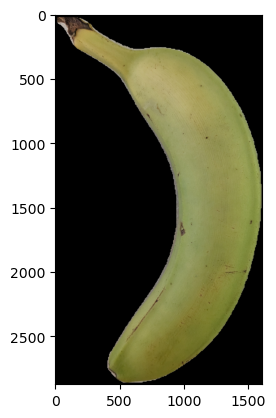

1/1 [==============================] - 0s 97ms/step
[          1  9.0389e-14  9.9592e-08  3.3722e-10]
2.0019557607802894e-07
78.125 %
file and hours Bananas time dataset/t0_48 (3).jpg 48.0



0: 480x640 1 banana, 3649.8ms
Speed: 11.0ms preprocess, 3649.8ms inference, 31.8ms postprocess per image at shape (1, 3, 640, 640)


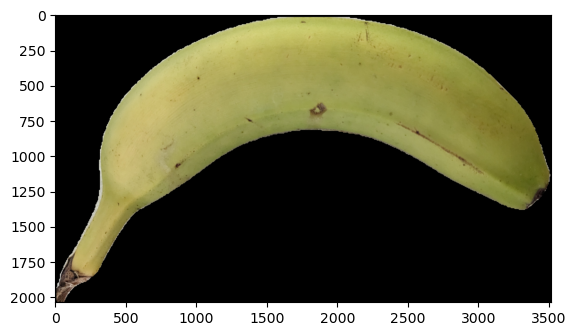

1/1 [==============================] - 0s 16ms/step
[   0.097403  7.5082e-05  6.7647e-08     0.90252]
2.707639511606118
81.25 %
file and hours Bananas time dataset/t0_48 (4).jpg 48.0



0: 480x640 1 knife, 1 banana, 3072.1ms
Speed: 0.0ms preprocess, 3072.1ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


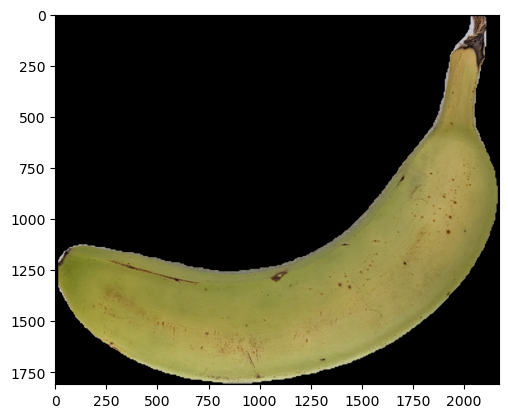

1/1 [==============================] - 0s 34ms/step
[    0.13193  0.00015442  1.6939e-07     0.86791]
2.6038871697686545
84.375 %
file and hours Bananas time dataset/t0_70 (1).jpg 70.0



0: 480x640 1 knife, 1 bowl, 1 banana, 3047.6ms
Speed: 4.0ms preprocess, 3047.6ms inference, 22.0ms postprocess per image at shape (1, 3, 640, 640)


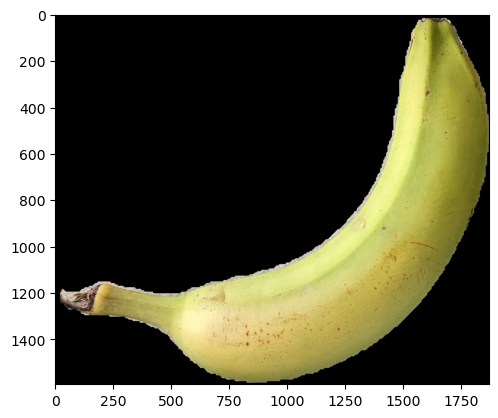

1/1 [==============================] - 0s 28ms/step
[    0.99967  4.0644e-08  0.00032335   1.146e-05]
0.0006811182189601084
87.5 %
file and hours Bananas time dataset/t0_70 (3).jpg 70.0



0: 480x640 1 knife, 1 bowl, 1 banana, 3066.9ms
Speed: 5.0ms preprocess, 3066.9ms inference, 27.7ms postprocess per image at shape (1, 3, 640, 640)


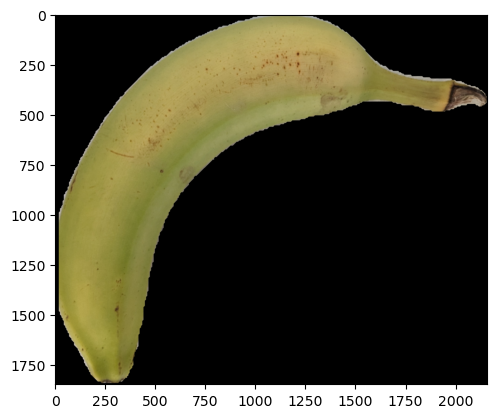

1/1 [==============================] - 0s 34ms/step
[  0.0039141    0.014039  1.0913e-05     0.98204]
2.9601696183181048
90.625 %
file and hours Bananas time dataset/t0_70 (4).jpg 70.0



0: 480x640 1 banana, 3030.6ms
Speed: 3.0ms preprocess, 3030.6ms inference, 28.9ms postprocess per image at shape (1, 3, 640, 640)


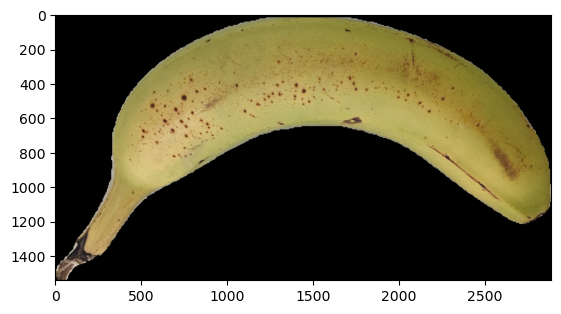

1/1 [==============================] - 0s 31ms/step
[ 0.00033837  9.1249e-06  1.4959e-12     0.99965]
2.998966639661639
93.75 %
file and hours Bananas time dataset/t0_97 (1).jpg 97.0



0: 480x640 1 knife, 1 banana, 3037.9ms
Speed: 0.0ms preprocess, 3037.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


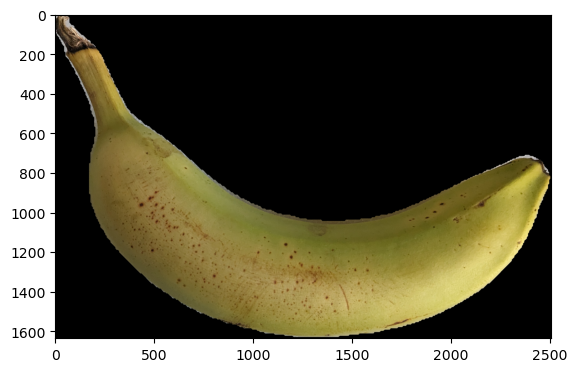

1/1 [==============================] - 0s 32ms/step
[ 1.9488e-05  6.3642e-06  1.3671e-11     0.99997]
2.999929116573241
96.875 %
file and hours Bananas time dataset/t0_97 (3).jpg 97.0



0: 480x640 1 banana, 3029.2ms
Speed: 2.1ms preprocess, 3029.2ms inference, 17.0ms postprocess per image at shape (1, 3, 640, 640)


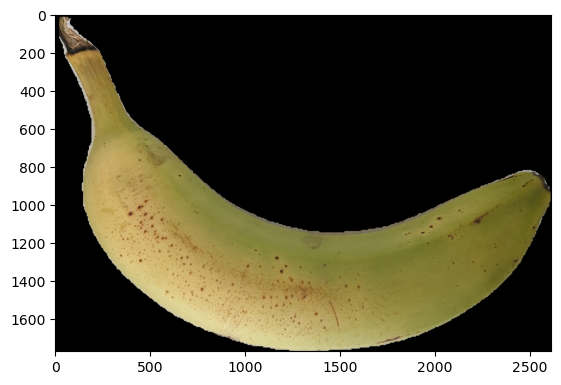

1/1 [==============================] - 0s 30ms/step
[ 0.00031952  2.3667e-05  1.6153e-09     0.99966]
2.998994059546051
100.0 %
file and hours Bananas time dataset/t0_97 (4).jpg 97.0
NaNs= []
[   0.004699     0.74588     0.84576      2.9927      1.7943      1.5552     0.89732      1.3128      1.6028      1.8582      2.4452      1.5354      2.6241      1.1851      1.9999  2.2495e-07    0.044075  2.9934e-07     0.05529     0.03517      1.2729       1.994    0.011363  7.2464e-07   2.002e-07      2.7076
      2.6039  0.00068112      2.9602       2.999      2.9999       2.999] [          0           0           0         124         124         146         146         146         146         167         167         193         193         217         217          24          24          24          24          24         241         241          48          48          48          48
          70          70          70          97          97          97] [   0.004699     0.74588     0.845

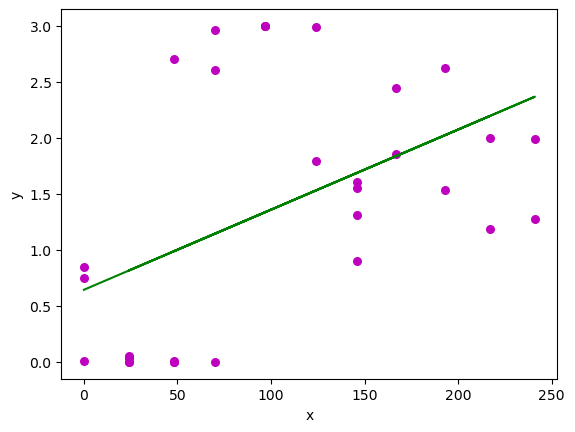

In [14]:
xx, yy = time_analysis(files, start_index[0], end_index[0])


0: 640x480 1 person, 1 banana, 2579.3ms
Speed: 5.0ms preprocess, 2579.3ms inference, 23.9ms postprocess per image at shape (1, 3, 640, 640)


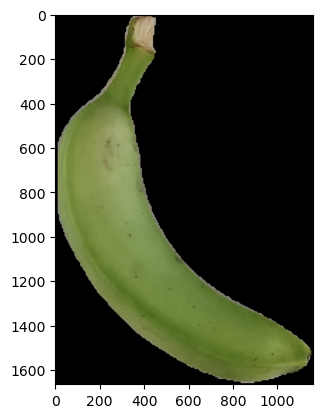

1/1 [==============================] - 0s 34ms/step
[          1  1.0636e-11  5.9957e-12  3.5283e-07]
1.058513053277775e-06
4.166666666666666 %
file and hours Bananas time dataset/t1_0 (4).jpg 0.0



0: 640x480 1 spoon, 1 banana, 2605.4ms
Speed: 0.0ms preprocess, 2605.4ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 640)


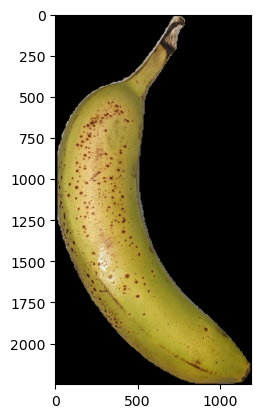

1/1 [==============================] - 0s 27ms/step
[ 1.0544e-06   0.0031669  6.3184e-11     0.99683]
2.9936631001864433
8.333333333333332 %
file and hours Bananas time dataset/t1_124 (1).jpg 124.0



0: 640x480 1 banana, 2690.3ms
Speed: 5.0ms preprocess, 2690.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


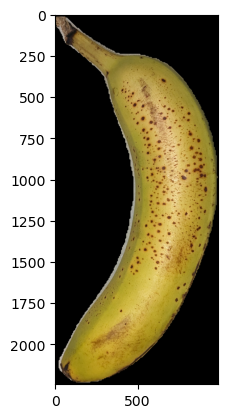

1/1 [==============================] - 0s 28ms/step


[ 3.0209e-07  0.00037968  3.6798e-17     0.99962]
2.9992395658337045
12.5 %
file and hours Bananas time dataset/t1_124 (2).jpg 124.0


0: 640x480 1 banana, 2661.1ms
Speed: 2.1ms preprocess, 2661.1ms inference, 18.8ms postprocess per image at shape (1, 3, 640, 640)


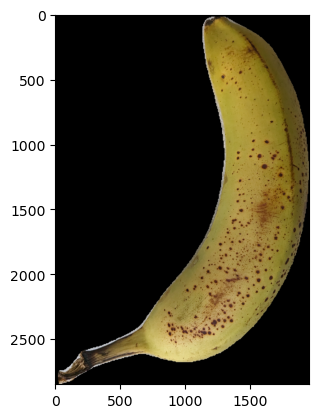

1/1 [==============================] - 0s 33ms/step


[ 0.00049251     0.04314  3.8324e-07     0.95637]
2.9122413834576264
16.666666666666664 %
file and hours Bananas time dataset/t1_146 (1).jpg 146.0


0: 640x480 1 banana, 2636.7ms
Speed: 18.8ms preprocess, 2636.7ms inference, 33.9ms postprocess per image at shape (1, 3, 640, 640)


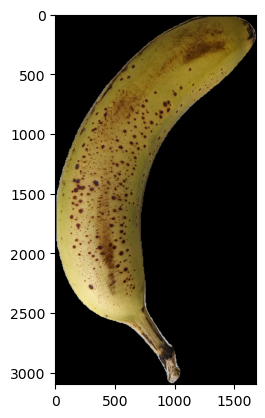

1/1 [==============================] - 0s 34ms/step
[ 1.1336e-05     0.73853  4.9154e-05     0.26141]
1.5228513090551132
20.833333333333336 %
file and hours Bananas time dataset/t1_146 (2).jpg 146.0



0: 480x640 1 banana, 2586.2ms
Speed: 0.0ms preprocess, 2586.2ms inference, 30.8ms postprocess per image at shape (1, 3, 640, 640)


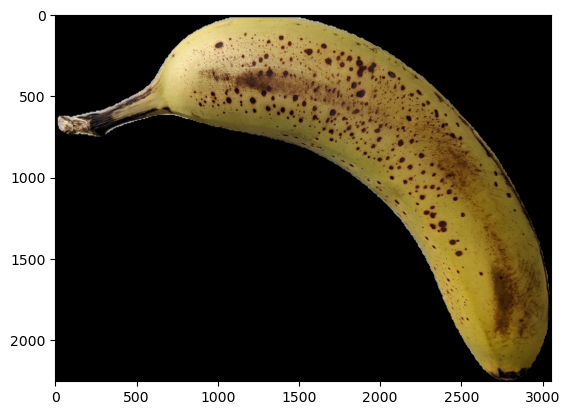

1/1 [==============================] - 0s 17ms/step


[ 2.1321e-05     0.97082    0.025447   0.0037145]
1.0328542201314121
25.0 %
file and hours Bananas time dataset/t1_167 (1).jpg 167.0


0: 640x480 1 cup, 1 banana, 2558.3ms
Speed: 16.8ms preprocess, 2558.3ms inference, 17.9ms postprocess per image at shape (1, 3, 640, 640)


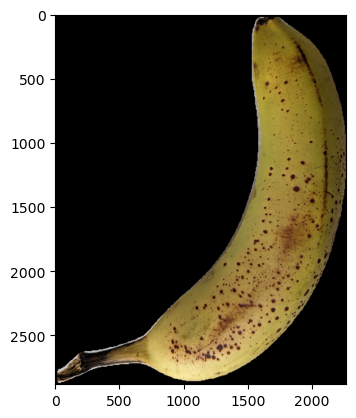

1/1 [==============================] - 0s 33ms/step
[ 0.00031502     0.24987  3.8505e-05     0.74977]
2.4992731217644177
29.166666666666668 %
file and hours Bananas time dataset/t1_167 (2).jpg 167.0



0: 640x480 1 snowboard, 1 cup, 1 banana, 2922.6ms
Speed: 5.0ms preprocess, 2922.6ms inference, 22.0ms postprocess per image at shape (1, 3, 640, 640)


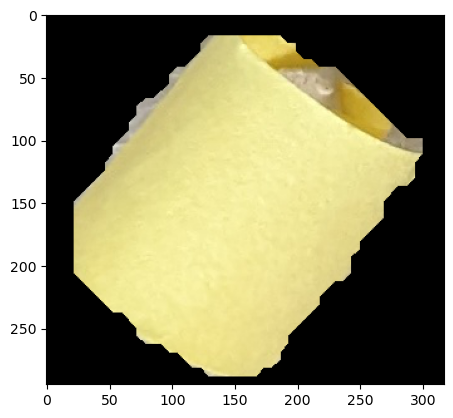

1/1 [==============================] - 0s 29ms/step
[          1   1.452e-16  1.7712e-16  3.9632e-13]
1.1894726665515243e-12
33.33333333333333 %
file and hours Bananas time dataset/t1_193 (1).jpg 193.0



0: 640x480 1 snowboard, 1 cup, 1 banana, 2963.9ms
Speed: 0.0ms preprocess, 2963.9ms inference, 23.9ms postprocess per image at shape (1, 3, 640, 640)


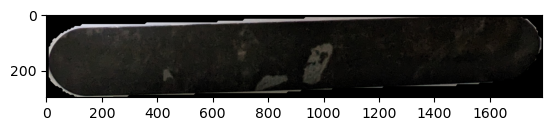

1/1 [==============================] - 0s 30ms/step
[   0.027795  8.8419e-09      0.9722  6.6942e-07]
1.9444098378054715
37.5 %
file and hours Bananas time dataset/t1_193 (2).jpg 193.0



0: 640x480 1 banana, 1 toilet, 3051.7ms
Speed: 4.0ms preprocess, 3051.7ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


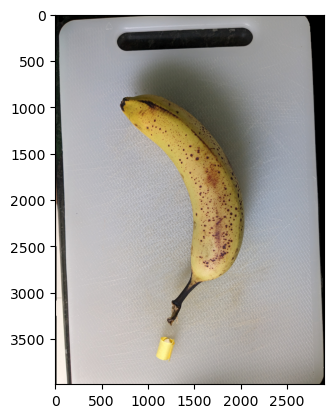

1/1 [==============================] - 0s 33ms/step
[  2.374e-24           0           1           0]
2.0
41.66666666666667 %
file and hours Bananas time dataset/t1_217 (2).jpg 217.0



0: 480x640 1 person, 1 banana, 1 toothbrush, 3050.6ms
Speed: 5.0ms preprocess, 3050.6ms inference, 23.9ms postprocess per image at shape (1, 3, 640, 640)


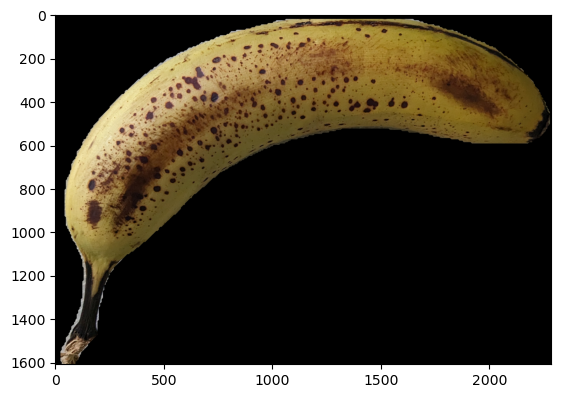

1/1 [==============================] - 0s 28ms/step
[ 9.1733e-06     0.53684     0.46055   0.0026019]
1.4657465850468725
45.83333333333333 %
file and hours Bananas time dataset/t1_217 (3).jpg 217.0



0: 480x640 1 banana, 3055.9ms
Speed: 4.0ms preprocess, 3055.9ms inference, 33.9ms postprocess per image at shape (1, 3, 640, 640)


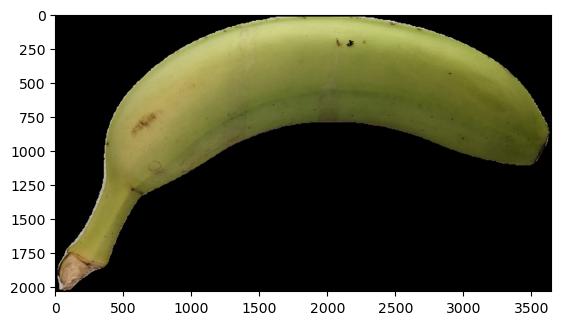

1/1 [==============================] - 0s 34ms/step
[  0.0010885  0.00022593  2.2038e-06     0.99868]
2.9962805125442173
50.0 %
file and hours Bananas time dataset/t1_24 (1).jpg 24.0



0: 480x640 1 knife, 1 banana, 3184.1ms
Speed: 0.0ms preprocess, 3184.1ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


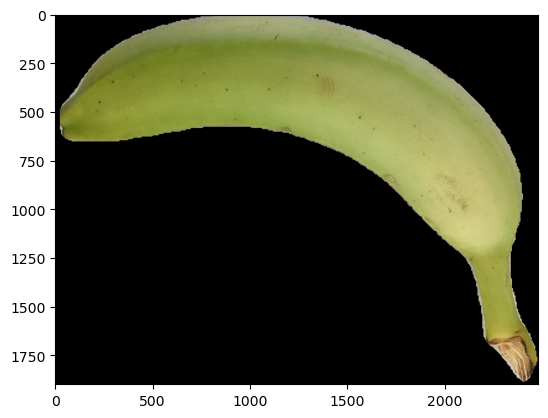

1/1 [==============================] - 0s 26ms/step


[   0.001472   0.0001481     0.99533   0.0030465]
1.9999544626916759
54.166666666666664 %
file and hours Bananas time dataset/t1_24 (3).jpg 24.0


0: 480x640 1 banana, 2979.2ms
Speed: 4.0ms preprocess, 2979.2ms inference, 33.9ms postprocess per image at shape (1, 3, 640, 640)


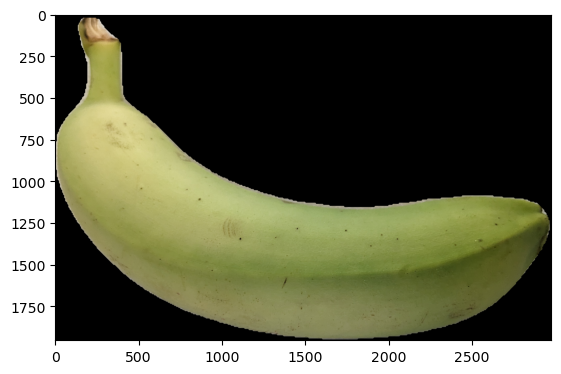

1/1 [==============================] - 0s 28ms/step
[          1  1.4229e-17  7.8237e-13  5.3319e-13]
3.1643309652261715e-12
58.333333333333336 %
file and hours Bananas time dataset/t1_24 (4).jpg 24.0



0: 640x480 1 banana, 2999.5ms
Speed: 0.0ms preprocess, 2999.5ms inference, 6.0ms postprocess per image at shape (1, 3, 640, 640)


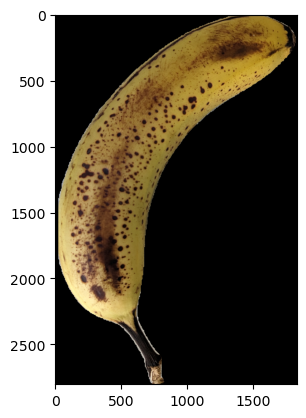

1/1 [==============================] - 0s 34ms/step
[ 8.2875e-06     0.87673     0.12278  0.00047809]
1.123729286249727
62.5 %
file and hours Bananas time dataset/t1_241 (1).jpg 241.0



0: 640x480 1 banana, 2881.6ms
Speed: 0.0ms preprocess, 2881.6ms inference, 15.9ms postprocess per image at shape (1, 3, 640, 640)


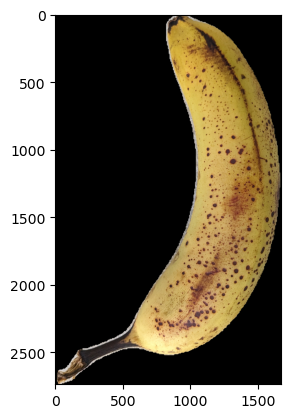

1/1 [==============================] - 0s 33ms/step
[  0.0048524     0.62884   0.0012045      0.3651]
1.7265616243239492
66.66666666666666 %
file and hours Bananas time dataset/t1_241 (2).jpg 241.0



0: 480x640 1 banana, 2924.7ms
Speed: 0.0ms preprocess, 2924.7ms inference, 34.0ms postprocess per image at shape (1, 3, 640, 640)


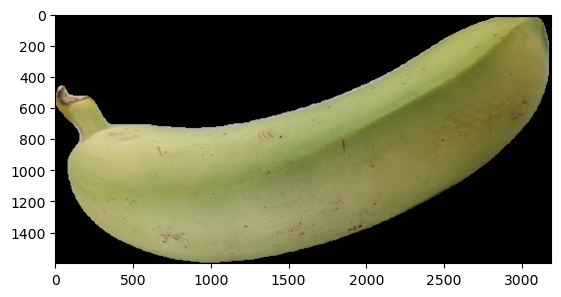

1/1 [==============================] - 0s 14ms/step
[          1  6.8857e-17  7.5803e-19  8.9061e-15]
2.6788586269150525e-14
70.83333333333334 %
file and hours Bananas time dataset/t1_48 (1).jpg 48.0



0: 480x640 1 kite, 1 banana, 3079.2ms
Speed: 6.1ms preprocess, 3079.2ms inference, 15.1ms postprocess per image at shape (1, 3, 640, 640)


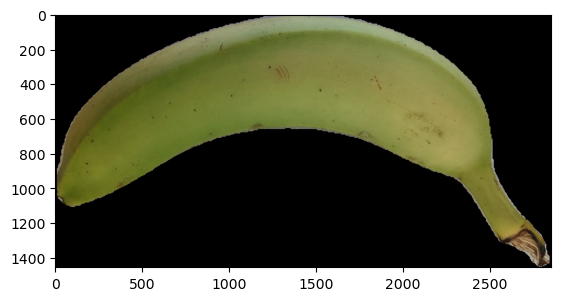

1/1 [==============================] - 0s 39ms/step
[    0.10543   3.662e-06  1.1893e-08     0.89457]
2.6837127707727717
75.0 %
file and hours Bananas time dataset/t1_48 (2).jpg 48.0



0: 480x640 1 banana, 2985.5ms
Speed: 3.0ms preprocess, 2985.5ms inference, 11.1ms postprocess per image at shape (1, 3, 640, 640)


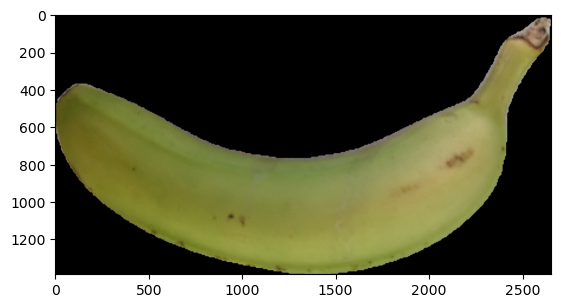

1/1 [==============================] - 0s 30ms/step


[          1  1.2561e-14  4.0939e-14  4.4363e-09]
1.330905770526978e-08
79.16666666666666 %
file and hours Bananas time dataset/t1_48 (3).jpg 48.0


0: 480x640 1 knife, 1 banana, 3110.9ms
Speed: 2.1ms preprocess, 3110.9ms inference, 15.1ms postprocess per image at shape (1, 3, 640, 640)


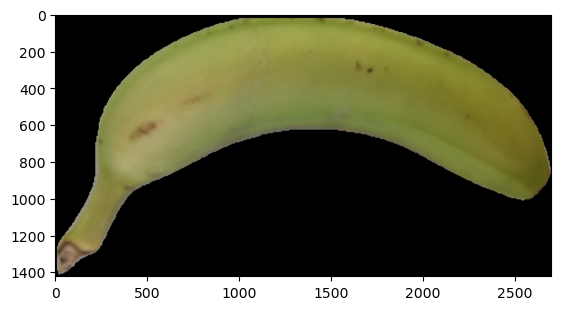

1/1 [==============================] - 0s 14ms/step
[    0.96781  7.1163e-07  1.8651e-09    0.032192]
0.09657577435276066
83.33333333333334 %
file and hours Bananas time dataset/t1_48 (4).jpg 48.0



0: 640x480 1 banana, 3343.6ms
Speed: 6.0ms preprocess, 3343.6ms inference, 12.0ms postprocess per image at shape (1, 3, 640, 640)


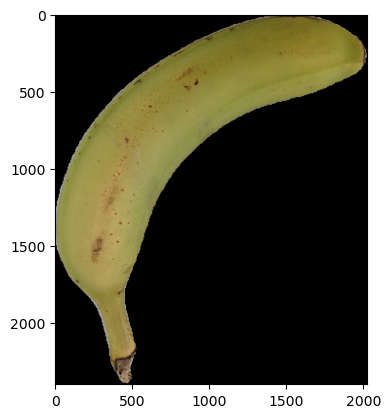

1/1 [==============================] - 0s 31ms/step


[ 0.00036714   0.0022057  1.8429e-07     0.99743]
2.9944868637318223
87.5 %
file and hours Bananas time dataset/t1_70 (1).jpg 70.0


0: 640x480 1 banana, 3634.5ms
Speed: 0.0ms preprocess, 3634.5ms inference, 30.8ms postprocess per image at shape (1, 3, 640, 640)


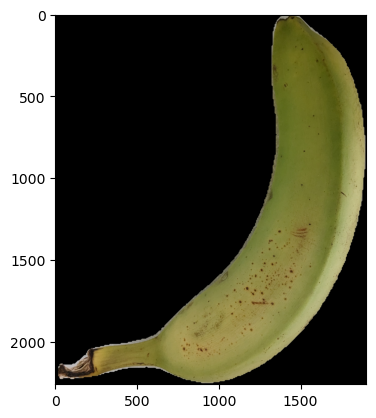

1/1 [==============================] - 0s 30ms/step
[    0.63176   0.0019004   0.0005097     0.36583]
1.1004139633150771
91.66666666666666 %
file and hours Bananas time dataset/t1_70 (3).jpg 70.0



0: 640x480 1 banana, 3640.6ms
Speed: 0.0ms preprocess, 3640.6ms inference, 34.6ms postprocess per image at shape (1, 3, 640, 640)


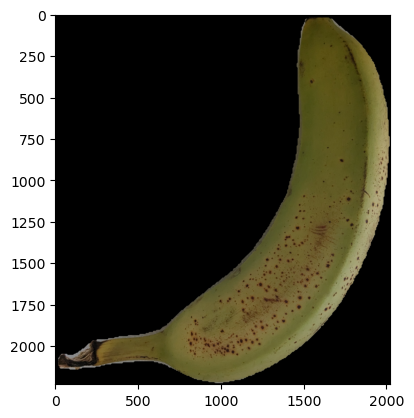

1/1 [==============================] - 0s 37ms/step
[    0.12451    0.076801   0.0096395     0.78905]
2.4632256627082825
95.83333333333334 %
file and hours Bananas time dataset/t1_97 (2).jpg 97.0



0: 640x480 1 banana, 3243.1ms
Speed: 0.0ms preprocess, 3243.1ms inference, 32.8ms postprocess per image at shape (1, 3, 640, 640)


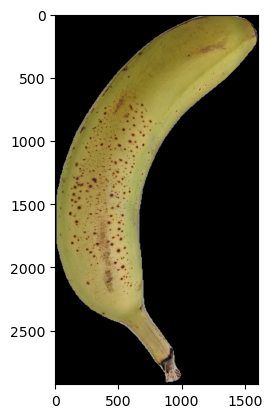

1/1 [==============================] - 0s 112ms/step
[ 0.00041625  8.5673e-05  4.5492e-11      0.9995]
2.9985797024019467
100.0 %
file and hours Bananas time dataset/t1_97 (3).jpg 97.0
NaNs= []
[ 1.0585e-06      2.9937      2.9992      2.9122      1.5229      1.0329      2.4993  1.1895e-12      1.9444           2      1.4657      2.9963           2  3.1643e-12      1.1237      1.7266  2.6789e-14      2.6837  1.3309e-08    0.096576      2.9945      1.1004      2.4632      2.9986] [          0         124         124         146         146         167         167         193         193         217         217          24          24          24         241         241          48          48          48          48          70          70          97          97] [ 1.0585e-06      2.9937      2.9992      2.9122      1.5229      1.0329      2.4993  1.1895e-12      1.9444           2      1.4657      2.9963           2  3.1643e-12      1.1237      1.7266  2.6789e-14      2.6837  1.3309e-

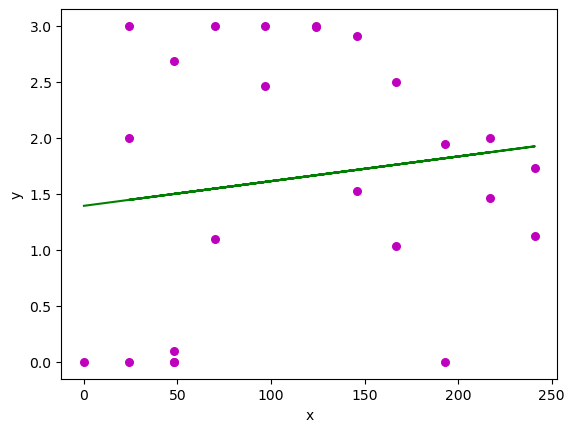

In [22]:
xx, yy = time_analysis(files, start_index[1], end_index[1])


0: 640x480 1 banana, 2 books, 2909.5ms
Speed: 0.4ms preprocess, 2909.5ms inference, 26.1ms postprocess per image at shape (1, 3, 640, 640)


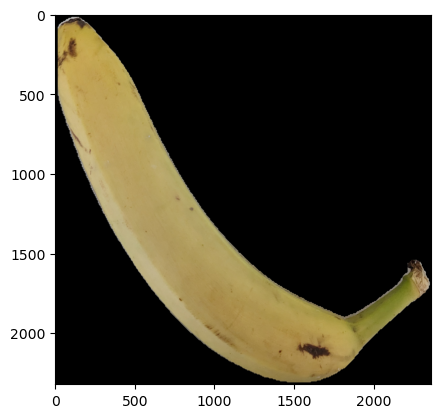

1/1 [==============================] - 0s 30ms/step
[  0.0027911    0.074035  2.7874e-07     0.92317]
2.84355699139752
3.4482758620689653 %
file and hours Bananas time dataset/t2_0 (1).jpg 0.0



0: 640x480 1 person, 1 knife, 1 banana, 2978.6ms
Speed: 6.0ms preprocess, 2978.6ms inference, 16.1ms postprocess per image at shape (1, 3, 640, 640)


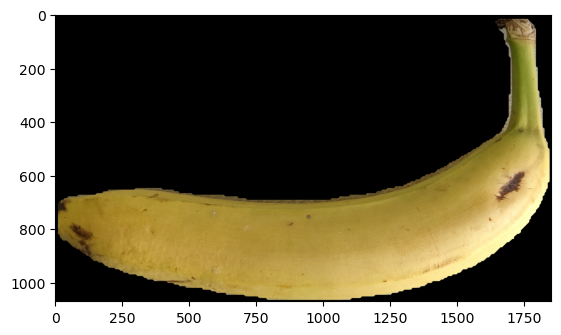

1/1 [==============================] - 0s 31ms/step
[ 3.3018e-07  0.00082545  7.2449e-09     0.99917]
2.9983480001061382
6.896551724137931 %
file and hours Bananas time dataset/t2_0 (2).jpg 0.0



0: 480x640 1 knife, 1 banana, 2749.0ms
Speed: 2.3ms preprocess, 2749.0ms inference, 21.5ms postprocess per image at shape (1, 3, 640, 640)


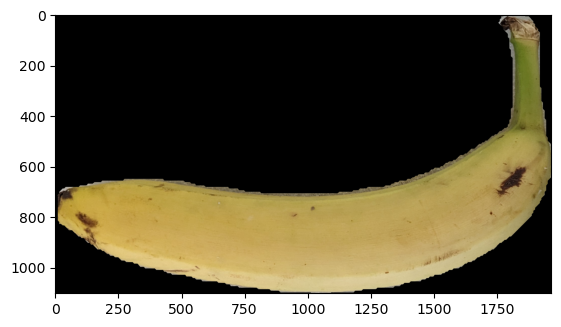

1/1 [==============================] - 0s 32ms/step
[ 1.5255e-06  0.00037244  8.0448e-10     0.99963]
2.9992505626660755
10.344827586206897 %
file and hours Bananas time dataset/t2_0 (3).jpg 0.0



0: 480x640 1 knife, 1 banana, 3063.6ms
Speed: 5.0ms preprocess, 3063.6ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


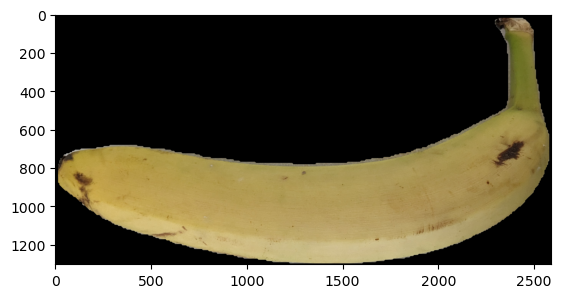

1/1 [==============================] - 0s 33ms/step
[ 1.5238e-05  0.00014708  4.1242e-12     0.99984]
2.9996599866800073
13.793103448275861 %
file and hours Bananas time dataset/t2_0 (4).jpg 0.0



0: 640x480 1 banana, 3918.9ms
Speed: 7.1ms preprocess, 3918.9ms inference, 29.1ms postprocess per image at shape (1, 3, 640, 640)


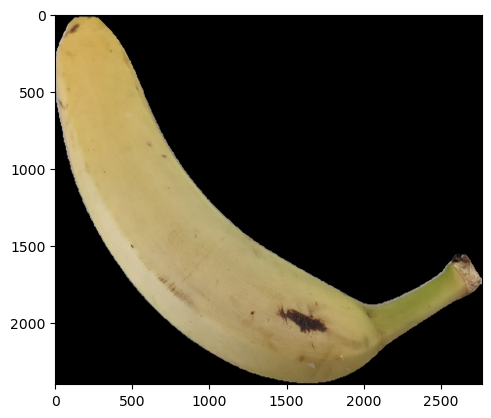

1/1 [==============================] - 0s 41ms/step
[    0.82203  0.00077128  6.2146e-05     0.17714]
0.5323052830790402
17.24137931034483 %
file and hours Bananas time dataset/t2_0 (5).jpg 0.0



0: 640x480 1 kite, 1 banana, 4229.0ms
Speed: 10.0ms preprocess, 4229.0ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


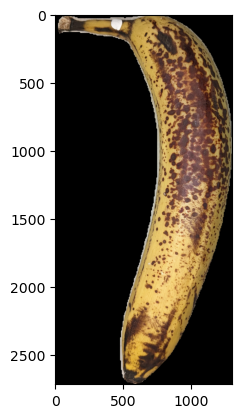

1/1 [==============================] - 0s 29ms/step
[ 0.00017584     0.96268   0.0055649    0.031576]
1.068541823886335
20.689655172413794 %
file and hours Bananas time dataset/t2_124 (1).jpg 124.0



0: 480x640 1 banana, 3349.7ms
Speed: 4.0ms preprocess, 3349.7ms inference, 25.1ms postprocess per image at shape (1, 3, 640, 640)


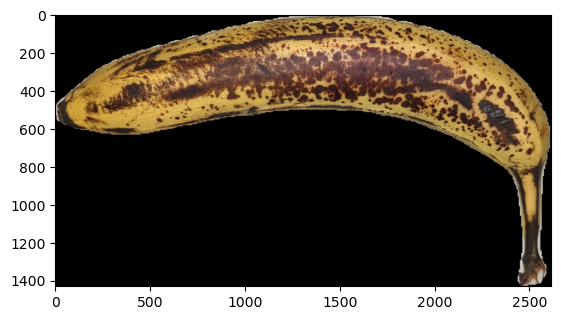

1/1 [==============================] - 0s 30ms/step
[ 1.7369e-09  1.6706e-07           1  1.3397e-09]
1.9999999326560132
24.137931034482758 %
file and hours Bananas time dataset/t2_124 (2).jpg 124.0



0: 480x640 1 frisbee, 1 surfboard, 3865.1ms
Speed: 7.0ms preprocess, 3865.1ms inference, 14.6ms postprocess per image at shape (1, 3, 640, 640)


no banana found
27.586206896551722 %
file and hours Bananas time dataset/t2_146 (1).jpg 146.0



0: 480x640 1 banana, 3905.3ms
Speed: 14.9ms preprocess, 3905.3ms inference, 29.0ms postprocess per image at shape (1, 3, 640, 640)


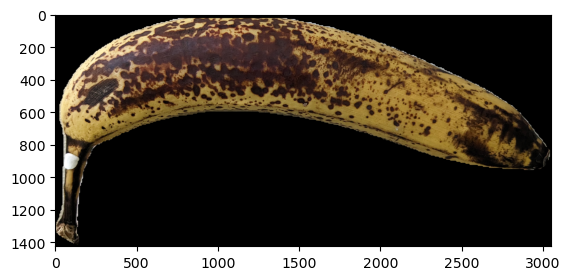

1/1 [==============================] - 0s 27ms/step
[ 1.4826e-11    0.021554    0.035199     0.94325]
2.921692492440343
31.03448275862069 %
file and hours Bananas time dataset/t2_146 (2).jpg 146.0



0: 480x640 1 knife, 1 banana, 4030.9ms
Speed: 7.1ms preprocess, 4030.9ms inference, 14.0ms postprocess per image at shape (1, 3, 640, 640)


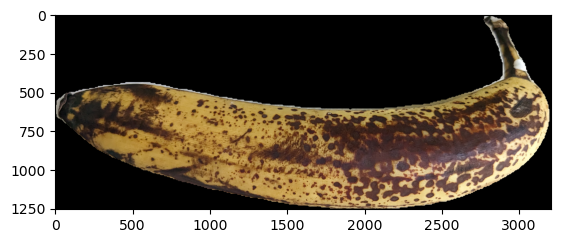

1/1 [==============================] - 0s 30ms/step
[ 1.6396e-13  1.9976e-14           1  2.5979e-14]
2.0000000000000977
34.48275862068966 %
file and hours Bananas time dataset/t2_146 (3).jpg 146.0



0: 480x640 1 knife, 3714.1ms
Speed: 7.0ms preprocess, 3714.1ms inference, 31.0ms postprocess per image at shape (1, 3, 640, 640)


no banana found
37.93103448275862 %
file and hours Bananas time dataset/t2_167 (1).jpg 167.0



0: 480x640 1 knife, 3510.0ms
Speed: 5.0ms preprocess, 3510.0ms inference, 17.0ms postprocess per image at shape (1, 3, 640, 640)


no banana found
41.37931034482759 %
file and hours Bananas time dataset/t2_167 (2).jpg 167.0



0: 640x480 1 surfboard, 3351.5ms
Speed: 6.0ms preprocess, 3351.5ms inference, 14.0ms postprocess per image at shape (1, 3, 640, 640)


no banana found
44.827586206896555 %
file and hours Bananas time dataset/t2_193 (1).jpg 193.0



0: 640x480 1 snowboard, 1 knife, 3042.9ms
Speed: 4.0ms preprocess, 3042.9ms inference, 19.9ms postprocess per image at shape (1, 3, 640, 640)


no banana found
48.275862068965516 %
file and hours Bananas time dataset/t2_193 (2).jpg 193.0



0: 480x640 1 banana, 3097.4ms
Speed: 23.9ms preprocess, 3097.4ms inference, 25.3ms postprocess per image at shape (1, 3, 640, 640)


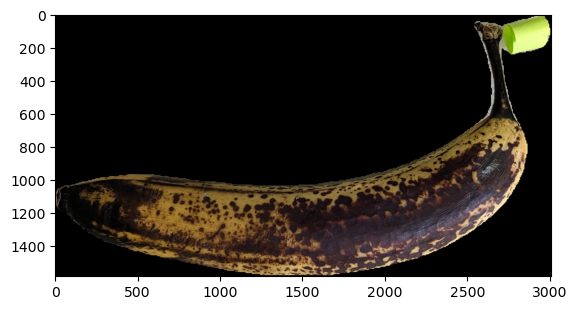

1/1 [==============================] - 0s 31ms/step
[ 7.9825e-16  5.5001e-28           1  4.6446e-29]
2.0
51.724137931034484 %
file and hours Bananas time dataset/t2_217 (1).jpg 217.0



0: 640x480 (no detections), 2986.8ms
Speed: 0.0ms preprocess, 2986.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


no banana found
55.172413793103445 %
file and hours Bananas time dataset/t2_217 (2).jpg 217.0



0: 640x480 1 banana, 4208.7ms
Speed: 9.0ms preprocess, 4208.7ms inference, 26.0ms postprocess per image at shape (1, 3, 640, 640)


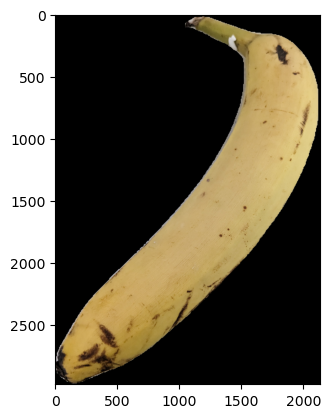

1/1 [==============================] - 0s 49ms/step
[    0.16078     0.35821  5.9341e-05     0.48094]
1.8011609400055022
58.620689655172406 %
file and hours Bananas time dataset/t2_24 (1).jpg 24.0



0: 640x480 1 banana, 4468.9ms
Speed: 5.0ms preprocess, 4468.9ms inference, 22.0ms postprocess per image at shape (1, 3, 640, 640)


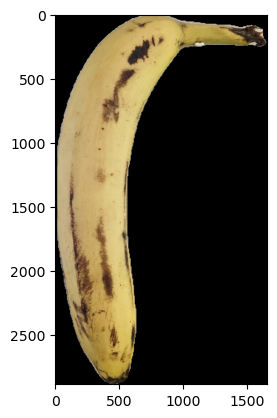

1/1 [==============================] - 0s 42ms/step
[   0.013471    0.078788  5.0781e-05     0.90769]
2.8019594724901253
62.06896551724138 %
file and hours Bananas time dataset/t2_24 (2).jpg 24.0



0: 640x480 1 banana, 4384.1ms
Speed: 4.1ms preprocess, 4384.1ms inference, 32.0ms postprocess per image at shape (1, 3, 640, 640)


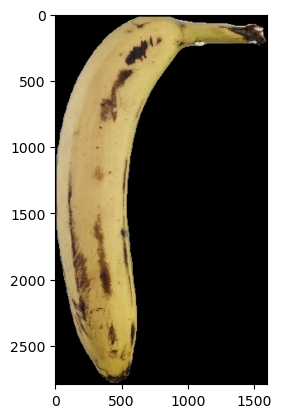

1/1 [==============================] - 0s 29ms/step
[ 0.00068109     0.29055  5.8967e-05     0.70871]
2.416794514581852
65.51724137931035 %
file and hours Bananas time dataset/t2_24 (3).jpg 24.0



0: 640x480 1 banana, 3689.9ms
Speed: 5.7ms preprocess, 3689.9ms inference, 15.1ms postprocess per image at shape (1, 3, 640, 640)


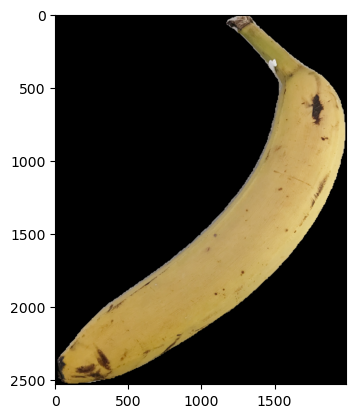

1/1 [==============================] - 0s 30ms/step
[ 0.00033114     0.63677  2.7277e-05     0.36288]
1.7254474014371226
68.96551724137932 %
file and hours Bananas time dataset/t2_24 (4).jpg 24.0



0: 640x480 1 knife, 1 banana, 3733.8ms
Speed: 3.0ms preprocess, 3733.8ms inference, 18.0ms postprocess per image at shape (1, 3, 640, 640)


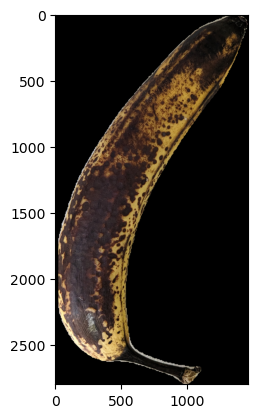

1/1 [==============================] - 0s 40ms/step
[ 4.4056e-17  1.0456e-30           1           0]
2.0
72.41379310344827 %
file and hours Bananas time dataset/t2_241 (1).jpg 241.0



0: 480x640 1 frisbee, 1 surfboard, 3895.7ms
Speed: 0.0ms preprocess, 3895.7ms inference, 17.0ms postprocess per image at shape (1, 3, 640, 640)


no banana found
75.86206896551724 %
file and hours Bananas time dataset/t2_241 (2).jpg 241.0



0: 480x640 1 bowl, 1 banana, 3180.5ms
Speed: 6.0ms preprocess, 3180.5ms inference, 13.7ms postprocess per image at shape (1, 3, 640, 640)


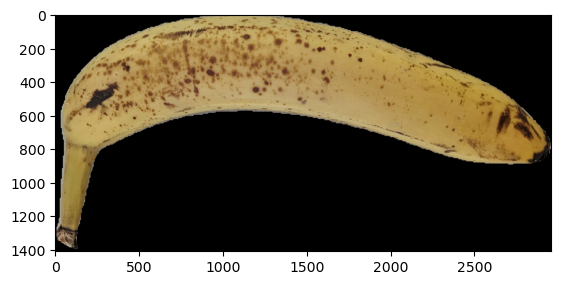

1/1 [==============================] - 0s 30ms/step
[ 1.6583e-05     0.12043  1.5067e-09     0.87955]
2.7590852707955733
79.3103448275862 %
file and hours Bananas time dataset/t2_48 (1).jpg 48.0



0: 640x480 1 person, 1 tie, 1 banana, 4571.0ms
Speed: 16.2ms preprocess, 4571.0ms inference, 28.0ms postprocess per image at shape (1, 3, 640, 640)


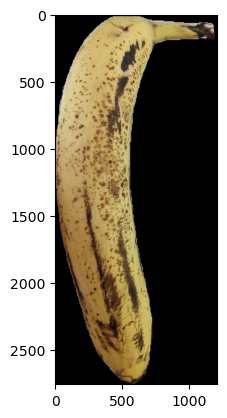

1/1 [==============================] - 0s 45ms/step
[ 8.9642e-05     0.44386  1.0125e-05     0.55604]
2.1119923145852226
82.75862068965517 %
file and hours Bananas time dataset/t2_48 (2).jpg 48.0



0: 640x480 1 kite, 1 banana, 3665.1ms
Speed: 5.0ms preprocess, 3665.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


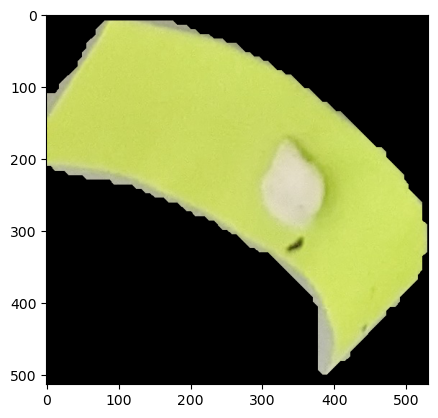

1/1 [==============================] - 0s 39ms/step
[          1  1.0407e-13  3.2424e-16  1.0821e-06]
3.2463907383703576e-06
86.20689655172413 %
file and hours Bananas time dataset/t2_48 (3).jpg 48.0



0: 640x480 1 person, 1 banana, 3644.1ms
Speed: 0.0ms preprocess, 3644.1ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


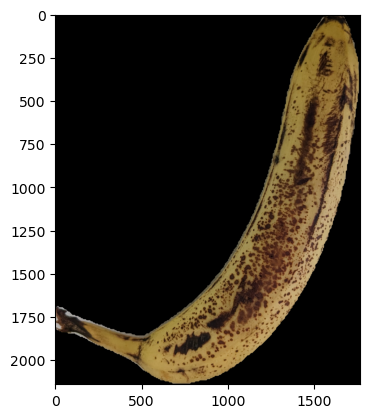

1/1 [==============================] - 0s 28ms/step
[ 4.4223e-06   0.0015213     0.99846  1.3464e-05]
1.9984834232482172
89.65517241379311 %
file and hours Bananas time dataset/t2_70 (3).jpg 70.0



0: 640x480 1 banana, 3514.5ms
Speed: 5.0ms preprocess, 3514.5ms inference, 29.2ms postprocess per image at shape (1, 3, 640, 640)


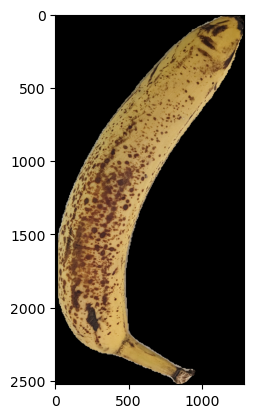

1/1 [==============================] - 0s 30ms/step
[ 2.9317e-07     0.99983   7.743e-05  9.6796e-05]
1.0002707862149691
93.10344827586206 %
file and hours Bananas time dataset/t2_70 (4).jpg 70.0



0: 640x480 1 banana, 3471.5ms
Speed: 5.0ms preprocess, 3471.5ms inference, 26.7ms postprocess per image at shape (1, 3, 640, 640)


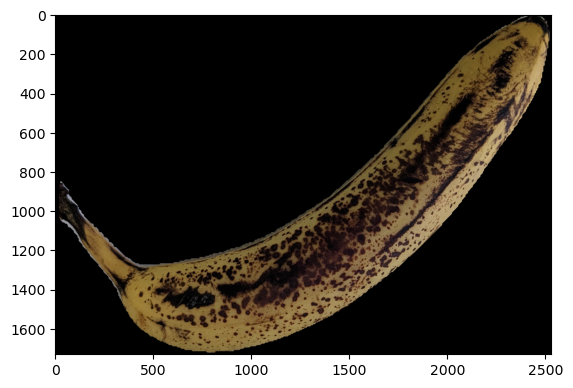

1/1 [==============================] - 0s 23ms/step
[  1.248e-07  1.5015e-18           1  1.4329e-19]
1.999999761581421
96.55172413793103 %
file and hours Bananas time dataset/t2_97 (3).jpg 97.0



0: 480x640 1 bird, 1 knife, 3446.8ms
Speed: 4.0ms preprocess, 3446.8ms inference, 23.0ms postprocess per image at shape (1, 3, 640, 640)


no banana found
100.0 %
file and hours Bananas time dataset/t2_97 (4).jpg 97.0
NaNs= []
[     2.8436      2.9983      2.9993      2.9997     0.53231      1.0685           2           0      2.9217           2           0           0           0           0           2           0      1.8012       2.802      2.4168      1.7254           2           0      2.7591       2.112  3.2464e-06      1.9985
      1.0003           2           0] [          0           0           0           0           0         124         124         146         146         146         167         167         193         193         217         217          24          24          24          24         241         241          48          48          48          70
          70          97          97] [     2.8436      2.9983      2.9993      2.9997     0.53231      1.0685           2           0      2.9217           2           0           0           0           0           2           0      1.8012      

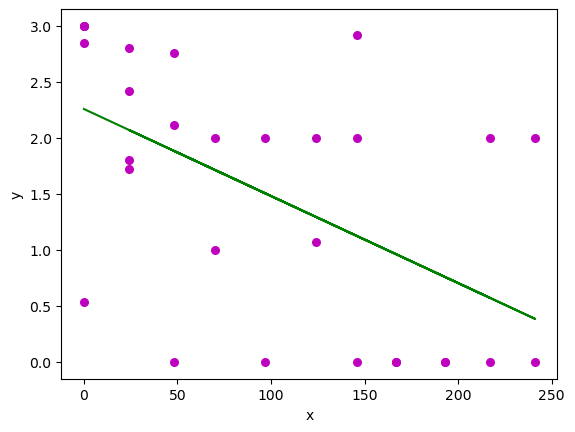

In [24]:
xx, yy = time_analysis(files, start_index[2], end_index[2])


0: 480x640 1 person, 1 banana, 2 books, 2851.2ms
Speed: 3.0ms preprocess, 2851.2ms inference, 16.7ms postprocess per image at shape (1, 3, 640, 640)


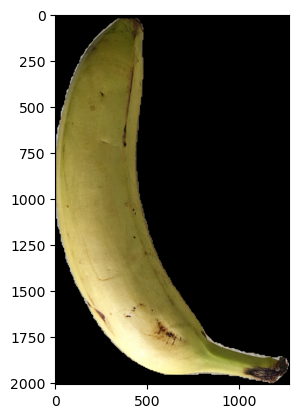

1/1 [==============================] - 0s 26ms/step
[ 4.8784e-05   0.0028607  3.1941e-09     0.99709]
2.994132414096337
3.8461538461538463 %
file and hours Bananas time dataset/t3_0 (2).jpg 0.0



0: 480x640 1 knife, 1 banana, 2859.4ms
Speed: 5.0ms preprocess, 2859.4ms inference, 11.2ms postprocess per image at shape (1, 3, 640, 640)


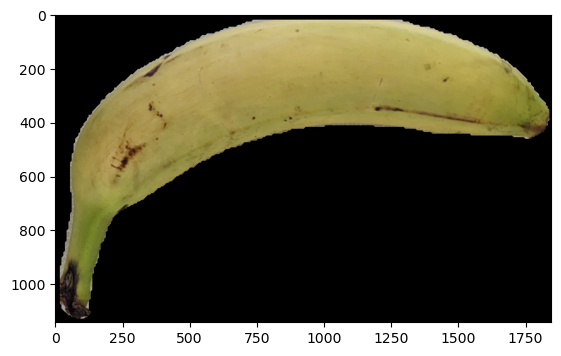

1/1 [==============================] - 0s 27ms/step
[ 4.5403e-07  0.00077356  7.1403e-11     0.99923]
2.9984514798534456
7.6923076923076925 %
file and hours Bananas time dataset/t3_0 (3).jpg 0.0



0: 640x480 1 banana, 2855.9ms
Speed: 20.5ms preprocess, 2855.9ms inference, 15.0ms postprocess per image at shape (1, 3, 640, 640)


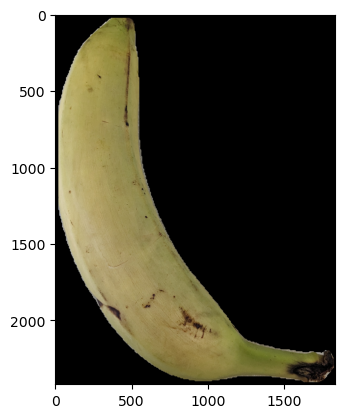

1/1 [==============================] - 0s 26ms/step
[  0.0083962   0.0015795   7.334e-08     0.99002]
2.9716519440949867
11.538461538461538 %
file and hours Bananas time dataset/t3_0 (4).jpg 0.0



0: 640x480 1 snowboard, 1 banana, 2745.9ms
Speed: 4.0ms preprocess, 2745.9ms inference, 14.0ms postprocess per image at shape (1, 3, 640, 640)


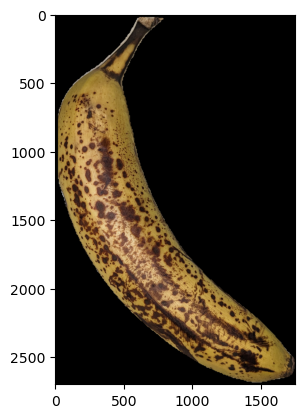

1/1 [==============================] - 0s 27ms/step
[ 7.0117e-06   0.0056578      0.9943  3.9134e-05]
1.9943674322166771
15.384615384615385 %
file and hours Bananas time dataset/t3_124 (2).jpg 124.0



0: 640x480 1 banana, 2816.4ms
Speed: 5.0ms preprocess, 2816.4ms inference, 31.0ms postprocess per image at shape (1, 3, 640, 640)


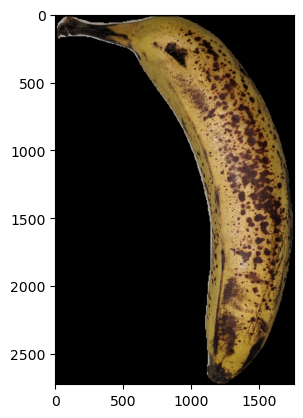

1/1 [==============================] - 0s 28ms/step
[ 1.1517e-06   0.0068182     0.99317  1.1432e-05]
1.9931908343551186
19.230769230769234 %
file and hours Bananas time dataset/t3_124 (3).jpg 124.0



0: 640x480 1 banana, 2834.5ms
Speed: 6.0ms preprocess, 2834.5ms inference, 15.0ms postprocess per image at shape (1, 3, 640, 640)


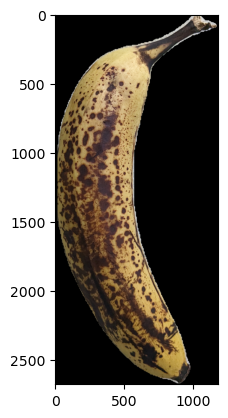

1/1 [==============================] - 0s 29ms/step
[    0.12112  3.8207e-06     0.87819  0.00068699]
1.7584453408039735
23.076923076923077 %
file and hours Bananas time dataset/t3_146 (1).jpg 146.0



0: 480x640 1 banana, 2899.4ms
Speed: 5.0ms preprocess, 2899.4ms inference, 15.0ms postprocess per image at shape (1, 3, 640, 640)


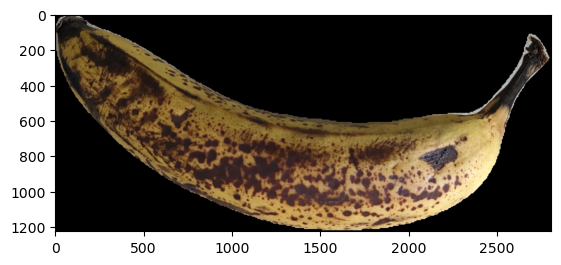

1/1 [==============================] - 0s 27ms/step
[   0.014881  5.8727e-09     0.98512  3.2154e-10]
1.9702385732359893
26.923076923076923 %
file and hours Bananas time dataset/t3_146 (2).jpg 146.0



0: 640x480 1 cup, 1 banana, 2757.5ms
Speed: 5.0ms preprocess, 2757.5ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


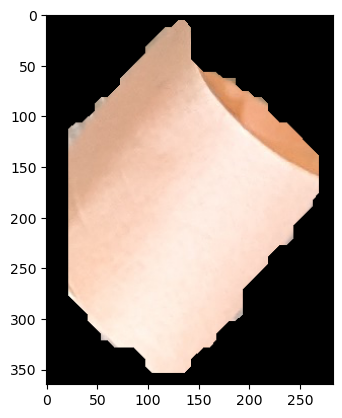

1/1 [==============================] - 0s 26ms/step
[          1  6.2539e-13  4.4019e-06  1.2321e-17]
8.80386386385581e-06
30.76923076923077 %
file and hours Bananas time dataset/t3_167 (1).jpg 167.0



0: 640x480 1 cup, 1 banana, 2859.1ms
Speed: 4.0ms preprocess, 2859.1ms inference, 15.0ms postprocess per image at shape (1, 3, 640, 640)


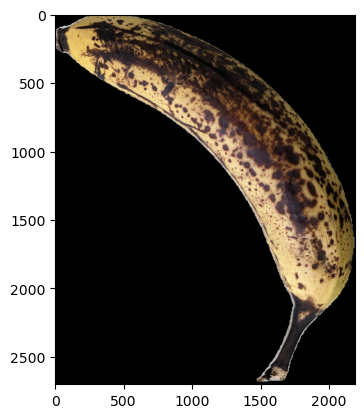

1/1 [==============================] - 0s 27ms/step
[ 1.9182e-05  5.6544e-09     0.99998  8.1732e-16]
1.9999616202631583
34.61538461538461 %
file and hours Bananas time dataset/t3_167 (2).jpg 167.0



0: 640x480 1 cup, 1 banana, 2790.5ms
Speed: 4.0ms preprocess, 2790.5ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


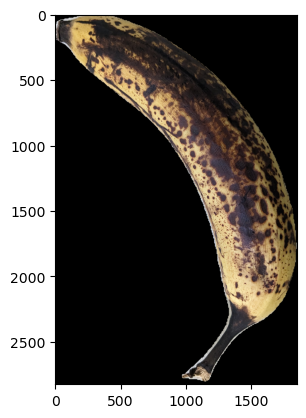

1/1 [==============================] - 0s 28ms/step
[    0.36369  7.2165e-21     0.63631  3.7218e-22]
1.2726259231567383
38.46153846153847 %
file and hours Bananas time dataset/t3_193 (1).jpg 193.0



0: 640x480 1 snowboard, 1 banana, 2776.6ms
Speed: 5.0ms preprocess, 2776.6ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


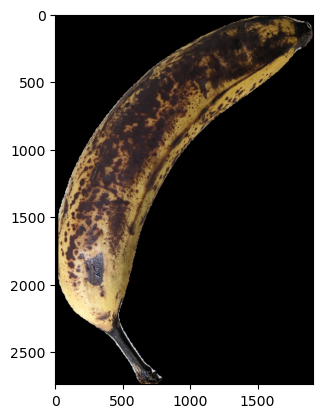

1/1 [==============================] - 0s 27ms/step
[ 0.00015559  3.6911e-18     0.99984  5.2431e-20]
1.9996888637542725
42.30769230769231 %
file and hours Bananas time dataset/t3_193 (2).jpg 193.0



0: 480x640 1 bird, 1 banana, 2776.5ms
Speed: 5.0ms preprocess, 2776.5ms inference, 14.0ms postprocess per image at shape (1, 3, 640, 640)


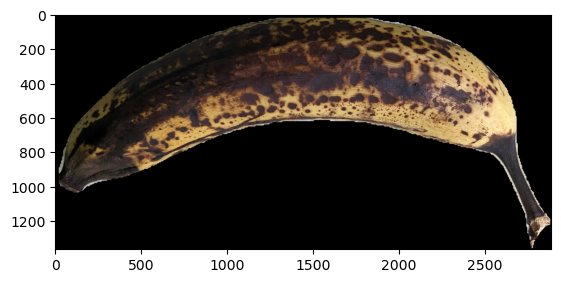

1/1 [==============================] - 0s 35ms/step
[ 7.4701e-09  4.3174e-09           1  1.3536e-06]
2.000001442654438
46.15384615384615 %
file and hours Bananas time dataset/t3_217 (1).jpg 217.0



0: 480x640 1 banana, 3553.1ms
Speed: 6.0ms preprocess, 3553.1ms inference, 40.0ms postprocess per image at shape (1, 3, 640, 640)


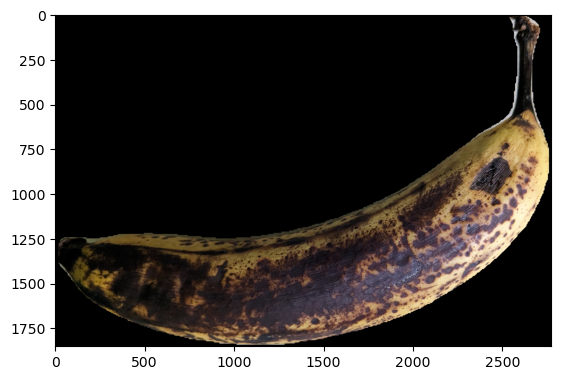

1/1 [==============================] - 0s 26ms/step
[ 7.4145e-17  2.4711e-34           1  6.4101e-36]
2.0
50.0 %
file and hours Bananas time dataset/t3_217 (2).jpg 217.0



0: 480x640 1 banana, 2949.7ms
Speed: 5.4ms preprocess, 2949.7ms inference, 15.9ms postprocess per image at shape (1, 3, 640, 640)


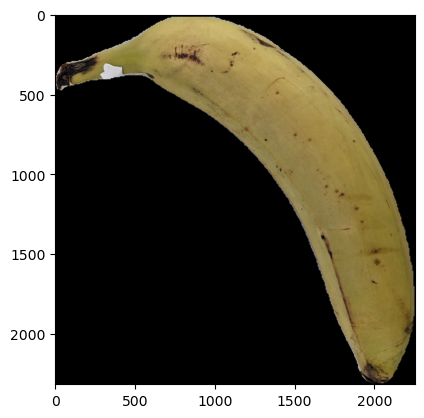

1/1 [==============================] - 0s 26ms/step
[ 2.2496e-05     0.14055  5.4736e-06     0.85942]
2.7188273468700572
53.84615384615385 %
file and hours Bananas time dataset/t3_24 (1).jpg 24.0



0: 480x640 1 kite, 1 banana, 2944.9ms
Speed: 4.1ms preprocess, 2944.9ms inference, 9.9ms postprocess per image at shape (1, 3, 640, 640)


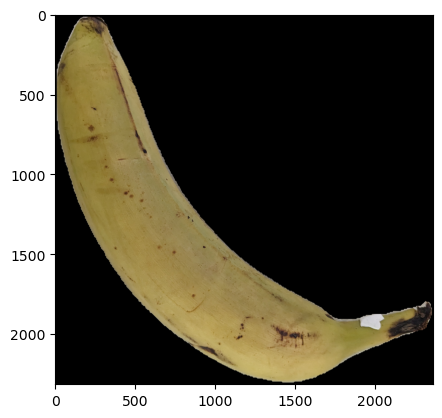

1/1 [==============================] - 0s 29ms/step
[ 0.00013793   0.0021332  2.7101e-09     0.99773]
2.995319832181543
57.692307692307686 %
file and hours Bananas time dataset/t3_24 (2).jpg 24.0



0: 640x480 1 banana, 2964.7ms
Speed: 5.0ms preprocess, 2964.7ms inference, 32.0ms postprocess per image at shape (1, 3, 640, 640)


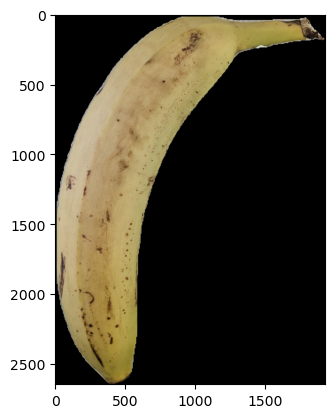

1/1 [==============================] - 0s 26ms/step
[ 0.00035342     0.49357  0.00012348     0.50595]
2.0116790062456857
61.53846153846154 %
file and hours Bananas time dataset/t3_24 (3).jpg 24.0



0: 480x640 1 banana, 2977.4ms
Speed: 5.0ms preprocess, 2977.4ms inference, 19.0ms postprocess per image at shape (1, 3, 640, 640)


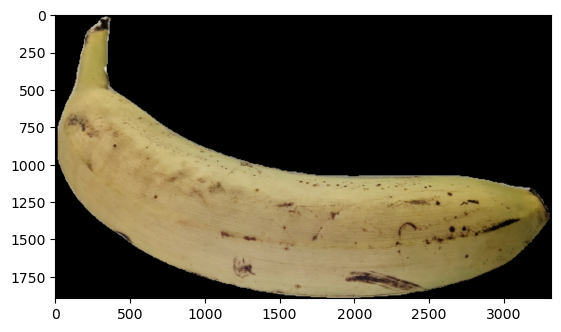

1/1 [==============================] - 0s 26ms/step
[    0.37406  0.00042415  8.4284e-09     0.62551]
1.8769641128367223
65.38461538461539 %
file and hours Bananas time dataset/t3_24 (4).jpg 24.0



0: 640x480 1 banana, 2950.3ms
Speed: 5.0ms preprocess, 2950.3ms inference, 26.0ms postprocess per image at shape (1, 3, 640, 640)


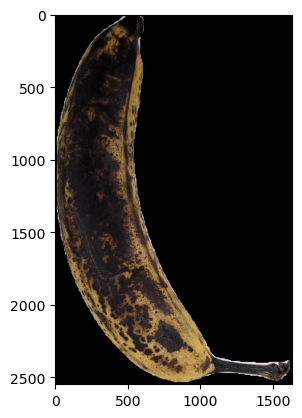

1/1 [==============================] - 0s 28ms/step
[          0           0           1           0]
2.0
69.23076923076923 %
file and hours Bananas time dataset/t3_240 (1).jpg 240.0



0: 480x640 1 bird, 2882.8ms
Speed: 5.0ms preprocess, 2882.8ms inference, 31.0ms postprocess per image at shape (1, 3, 640, 640)


no banana found
73.07692307692307 %
file and hours Bananas time dataset/t3_240 (2).jpg 240.0



0: 480x640 1 knife, 1 banana, 2826.6ms
Speed: 5.0ms preprocess, 2826.6ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


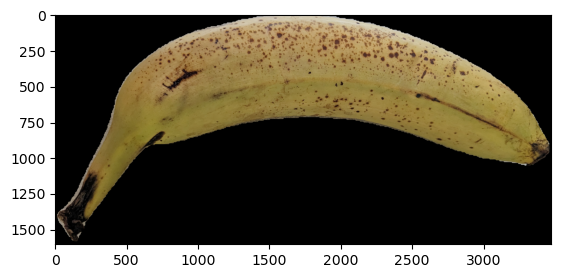

1/1 [==============================] - 0s 28ms/step
[ 7.7773e-06     0.22775  2.5375e-10     0.77225]
2.5444851522752385
76.92307692307693 %
file and hours Bananas time dataset/t3_48 (1).jpg 48.0



0: 480x640 1 banana, 2903.4ms
Speed: 5.0ms preprocess, 2903.4ms inference, 16.8ms postprocess per image at shape (1, 3, 640, 640)


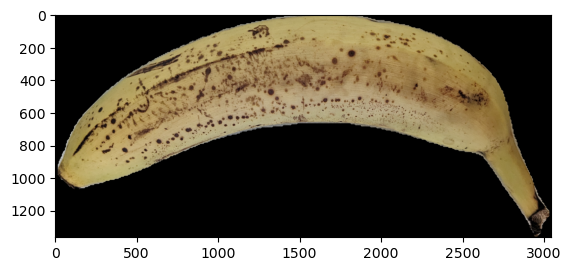

1/1 [==============================] - 0s 28ms/step
[    0.05665     0.36676  5.8884e-05     0.57654]
2.0964796145199216
80.76923076923077 %
file and hours Bananas time dataset/t3_48 (2).jpg 48.0



0: 480x640 1 knife, 1 banana, 2923.9ms
Speed: 4.0ms preprocess, 2923.9ms inference, 12.0ms postprocess per image at shape (1, 3, 640, 640)


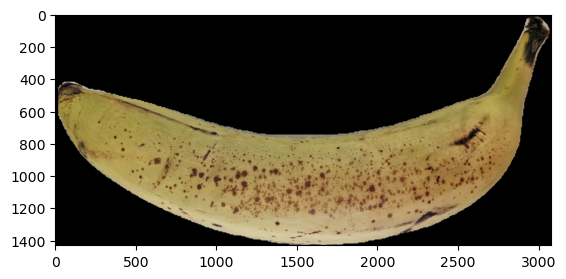

1/1 [==============================] - 0s 27ms/step
[ 2.6953e-05  0.00049287   1.262e-12     0.99948]
2.998933432975514
84.61538461538461 %
file and hours Bananas time dataset/t3_48 (3).jpg 48.0



0: 640x480 1 banana, 2957.4ms
Speed: 5.0ms preprocess, 2957.4ms inference, 28.4ms postprocess per image at shape (1, 3, 640, 640)


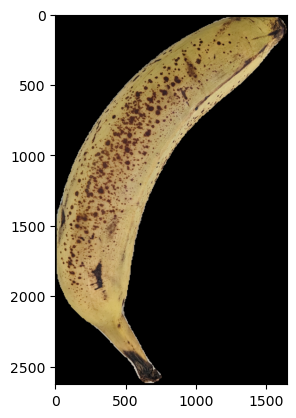

1/1 [==============================] - 0s 29ms/step
[ 6.2718e-05     0.97349    0.017857   0.0085946]
1.0349836256355047
88.46153846153845 %
file and hours Bananas time dataset/t3_70 (1).jpg 70.0



0: 640x480 1 snowboard, 2879.4ms
Speed: 4.0ms preprocess, 2879.4ms inference, 15.0ms postprocess per image at shape (1, 3, 640, 640)


no banana found
92.3076923076923 %
file and hours Bananas time dataset/t3_70 (2).jpg 70.0



0: 640x480 1 banana, 2959.2ms
Speed: 3.0ms preprocess, 2959.2ms inference, 19.9ms postprocess per image at shape (1, 3, 640, 640)


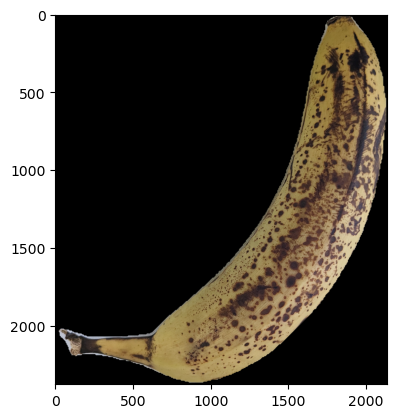

1/1 [==============================] - 0s 31ms/step
[ 0.00038776  1.0402e-06     0.99961  6.6724e-07]
1.9992242476498063
96.15384615384616 %
file and hours Bananas time dataset/t3_97 (2).jpg 97.0



0: 480x640 1 bird, 1 banana, 3047.4ms
Speed: 5.4ms preprocess, 3047.4ms inference, 11.0ms postprocess per image at shape (1, 3, 640, 640)


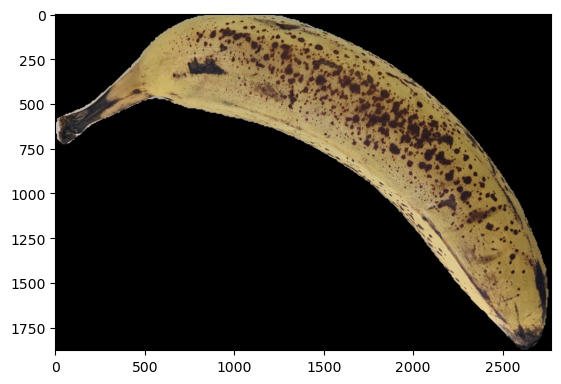

1/1 [==============================] - 0s 27ms/step
[ 0.00011309    0.034338     0.96517  0.00037622]
1.9658121135435067
100.0 %
file and hours Bananas time dataset/t3_97 (3).jpg 97.0
NaNs= []
[     2.9941      2.9985      2.9717      1.9944      1.9932      1.7584      1.9702  8.8039e-06           2      1.2726      1.9997           2           2      2.7188      2.9953      2.0117       1.877           2           0      2.5445      2.0965      2.9989       1.035           0      1.9992      1.9658] [          0           0           0         124         124         146         146         167         167         193         193         217         217          24          24          24          24         240         240          48          48          48          70          70          97          97] [     2.9941      2.9985      2.9717      1.9944      1.9932      1.7584      1.9702  8.8039e-06           2      1.2726      1.9997           2           2      2.7188      2.995

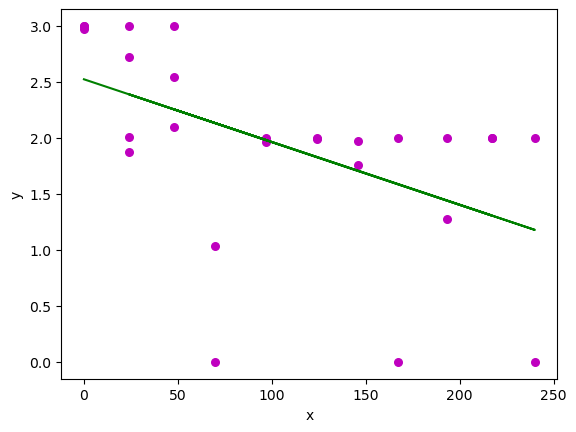

In [ ]:
xx, yy = time_analysis(files, start_index[3], end_index[3])


0: 480x640 1 knife, 1 banana, 2976.9ms
Speed: 4.0ms preprocess, 2976.9ms inference, 12.0ms postprocess per image at shape (1, 3, 640, 640)


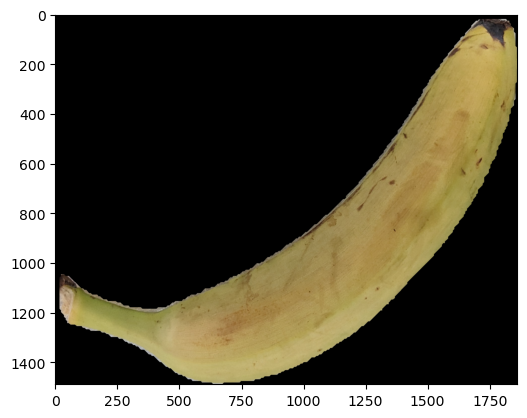

1/1 [==============================] - 0s 28ms/step
[      0.001    0.050843  4.0232e-07     0.94816]
2.8953137732812593
3.7037037037037033 %
file and hours Bananas time dataset/t4_0 (2).jpg 0.0



0: 480x640 1 banana, 2912.4ms
Speed: 6.0ms preprocess, 2912.4ms inference, 18.0ms postprocess per image at shape (1, 3, 640, 640)


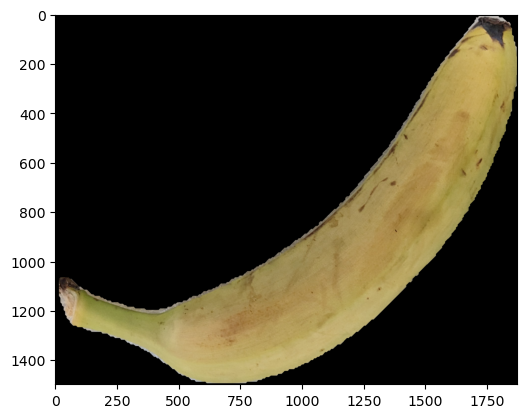

1/1 [==============================] - 0s 29ms/step
[  0.0015794    0.065005  6.1859e-07     0.93342]
2.8652517352315954
7.4074074074074066 %
file and hours Bananas time dataset/t4_0 (3).jpg 0.0



0: 480x640 1 bowl, 1 banana, 2971.6ms
Speed: 4.1ms preprocess, 2971.6ms inference, 20.1ms postprocess per image at shape (1, 3, 640, 640)


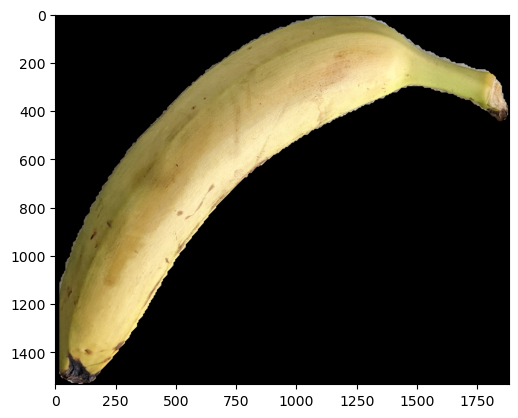

1/1 [==============================] - 0s 28ms/step
[   0.012706   0.0026299  1.3751e-05     0.98465]
2.956608698814307
11.11111111111111 %
file and hours Bananas time dataset/t4_0 (4).jpg 0.0



0: 640x480 1 toothbrush, 2965.8ms
Speed: 5.3ms preprocess, 2965.8ms inference, 17.7ms postprocess per image at shape (1, 3, 640, 640)


no banana found
14.814814814814813 %
file and hours Bananas time dataset/t4_0 (7).jpg 0.0



0: 640x480 1 banana, 3018.3ms
Speed: 3.0ms preprocess, 3018.3ms inference, 18.0ms postprocess per image at shape (1, 3, 640, 640)


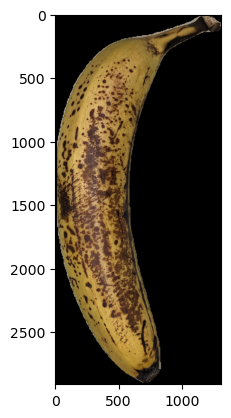

1/1 [==============================] - 0s 31ms/step
[ 5.3464e-05     0.47274     0.52387   0.0033327]
1.5304811079986393
18.51851851851852 %
file and hours Bananas time dataset/t4_124 (2).jpg 124.0



0: 640x480 1 banana, 2943.2ms
Speed: 5.0ms preprocess, 2943.2ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


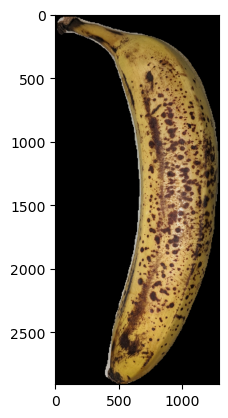

1/1 [==============================] - 0s 32ms/step
[ 4.5306e-06     0.18657     0.81269  0.00073651]
1.8141581455711275
22.22222222222222 %
file and hours Bananas time dataset/t4_124 (3).jpg 124.0



0: 640x480 1 banana, 2958.5ms
Speed: 5.0ms preprocess, 2958.5ms inference, 23.2ms postprocess per image at shape (1, 3, 640, 640)


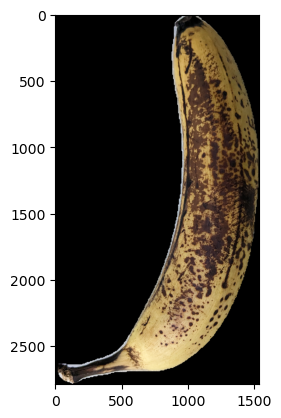

1/1 [==============================] - 0s 29ms/step
[  0.0032916   3.283e-07     0.99671  5.0778e-07]
1.9934169689169892
25.925925925925924 %
file and hours Bananas time dataset/t4_146 (1).jpg 146.0



0: 480x640 1 surfboard, 1 banana, 2935.4ms
Speed: 4.0ms preprocess, 2935.4ms inference, 12.0ms postprocess per image at shape (1, 3, 640, 640)


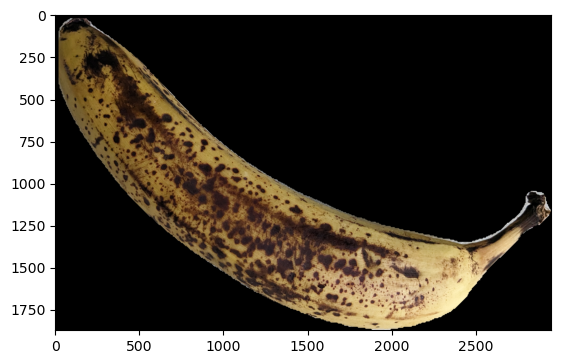

1/1 [==============================] - 0s 30ms/step
[ 3.5978e-05   2.612e-06     0.99996  3.1407e-08]
1.999925458592358
29.629629629629626 %
file and hours Bananas time dataset/t4_146 (2).jpg 146.0



0: 640x480 1 banana, 2876.0ms
Speed: 5.0ms preprocess, 2876.0ms inference, 27.0ms postprocess per image at shape (1, 3, 640, 640)


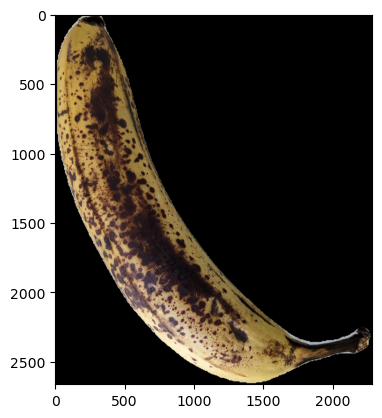

1/1 [==============================] - 0s 27ms/step
[          1  7.8994e-31  4.3578e-14           0]
8.715673582154748e-14
33.33333333333333 %
file and hours Bananas time dataset/t4_167 (1).jpg 167.0



0: 640x480 1 banana, 2947.9ms
Speed: 4.0ms preprocess, 2947.9ms inference, 15.4ms postprocess per image at shape (1, 3, 640, 640)


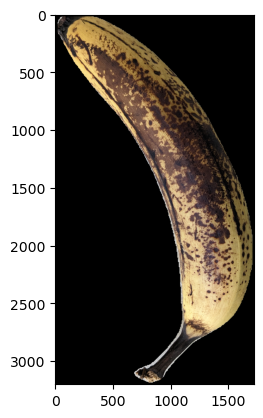

1/1 [==============================] - 0s 29ms/step
[    0.99658  7.2929e-14   0.0034186   1.974e-19]
0.006837118417097543
37.03703703703704 %
file and hours Bananas time dataset/t4_167 (2).jpg 167.0



0: 640x480 1 banana, 2909.7ms
Speed: 3.1ms preprocess, 2909.7ms inference, 24.5ms postprocess per image at shape (1, 3, 640, 640)


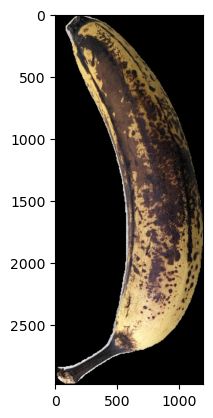

1/1 [==============================] - 0s 30ms/step
[    0.88766  1.0298e-27     0.11234  3.6751e-28]
0.22467546164989471
40.74074074074074 %
file and hours Bananas time dataset/t4_193 (1).jpg 193.0



0: 640x480 1 banana, 2888.6ms
Speed: 4.0ms preprocess, 2888.6ms inference, 30.0ms postprocess per image at shape (1, 3, 640, 640)


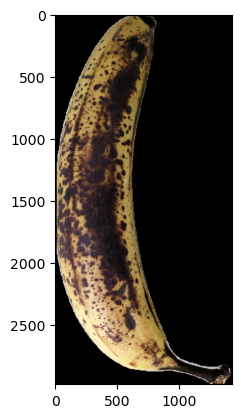

1/1 [==============================] - 0s 27ms/step
[          1           0  9.6537e-11           0]
1.9307445919825028e-10
44.44444444444444 %
file and hours Bananas time dataset/t4_193 (2).jpg 193.0



0: 480x640 1 banana, 2855.3ms
Speed: 4.0ms preprocess, 2855.3ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


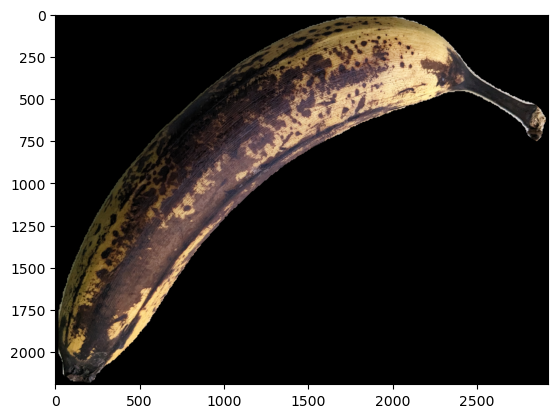

1/1 [==============================] - 0s 28ms/step
[          1  1.1266e-27  7.8261e-17  1.6246e-20]
1.5657061902390933e-16
48.148148148148145 %
file and hours Bananas time dataset/t4_217 (1).jpg 217.0



0: 480x640 1 surfboard, 1 banana, 3714.2ms
Speed: 6.0ms preprocess, 3714.2ms inference, 19.1ms postprocess per image at shape (1, 3, 640, 640)


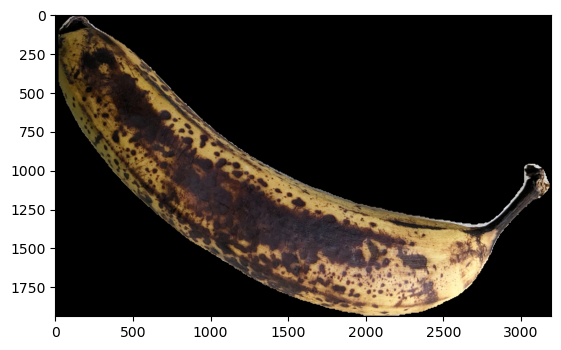

1/1 [==============================] - 0s 34ms/step
[          1           0  1.7123e-09           0]
3.424664329898519e-09
51.85185185185185 %
file and hours Bananas time dataset/t4_217 (2).jpg 217.0



0: 480x640 1 knife, 1 banana, 3143.7ms
Speed: 27.0ms preprocess, 3143.7ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


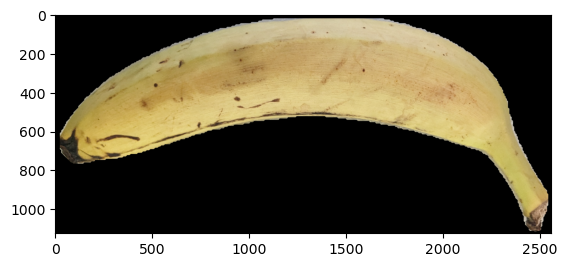

1/1 [==============================] - 0s 26ms/step
[ 2.3879e-06  4.8101e-05  2.9688e-11     0.99995]
2.999896466536743
55.55555555555556 %
file and hours Bananas time dataset/t4_24 (1).jpg 24.0



0: 640x480 1 banana, 3015.1ms
Speed: 3.0ms preprocess, 3015.1ms inference, 15.3ms postprocess per image at shape (1, 3, 640, 640)


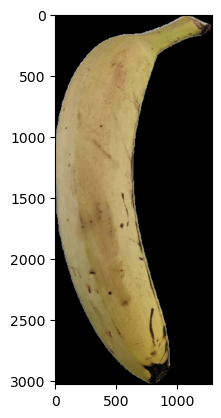

1/1 [==============================] - 0s 30ms/step
[ 2.3205e-07  6.0248e-05  2.4032e-14     0.99994]
2.9998789307174345
59.25925925925925 %
file and hours Bananas time dataset/t4_24 (2).jpg 24.0



0: 640x480 1 person, 1 banana, 2975.3ms
Speed: 4.0ms preprocess, 2975.3ms inference, 17.4ms postprocess per image at shape (1, 3, 640, 640)


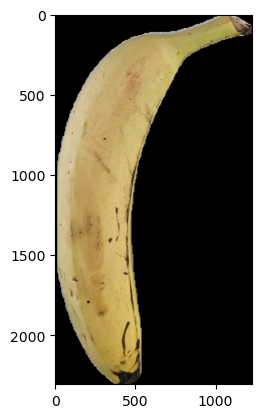

1/1 [==============================] - 0s 30ms/step
[ 4.1828e-07   0.0015764  4.4061e-09     0.99842]
2.9968457409060294
62.96296296296296 %
file and hours Bananas time dataset/t4_24 (3).jpg 24.0



0: 640x480 1 banana, 2939.1ms
Speed: 5.0ms preprocess, 2939.1ms inference, 18.3ms postprocess per image at shape (1, 3, 640, 640)


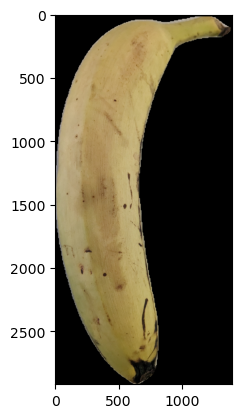

1/1 [==============================] - 0s 28ms/step
[ 1.1837e-07  1.6932e-05   5.206e-14     0.99998]
2.9999657909266846
66.66666666666666 %
file and hours Bananas time dataset/t4_24 (4).jpg 24.0



0: 640x480 1 banana, 2962.5ms
Speed: 5.0ms preprocess, 2962.5ms inference, 17.0ms postprocess per image at shape (1, 3, 640, 640)


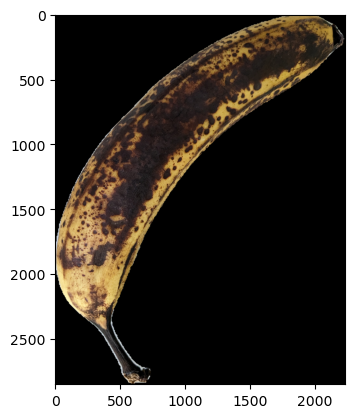

1/1 [==============================] - 0s 28ms/step
[          1  7.5747e-16  1.4286e-14   1.469e-11]
4.409969636355913e-11
70.37037037037037 %
file and hours Bananas time dataset/t4_241 (1).jpg 241.0



0: 640x480 1 banana, 1 vase, 2937.1ms
Speed: 6.0ms preprocess, 2937.1ms inference, 20.5ms postprocess per image at shape (1, 3, 640, 640)


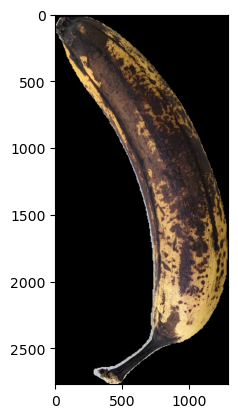

1/1 [==============================] - 0s 27ms/step
[ 2.6413e-14  6.9996e-30           1  1.3931e-36]
2.0
74.07407407407408 %
file and hours Bananas time dataset/t4_241 (2).jpg 241.0



0: 480x640 1 knife, 1 banana, 3041.0ms
Speed: 4.1ms preprocess, 3041.0ms inference, 17.0ms postprocess per image at shape (1, 3, 640, 640)


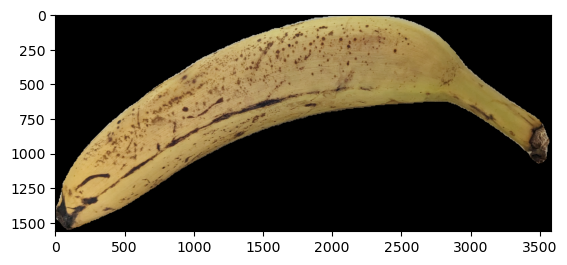

1/1 [==============================] - 0s 28ms/step
[ 7.1888e-06     0.81468  4.3443e-08     0.18532]
1.3706230943026014
77.77777777777779 %
file and hours Bananas time dataset/t4_48 (1).jpg 48.0



0: 480x640 1 banana, 2858.7ms
Speed: 4.0ms preprocess, 2858.7ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


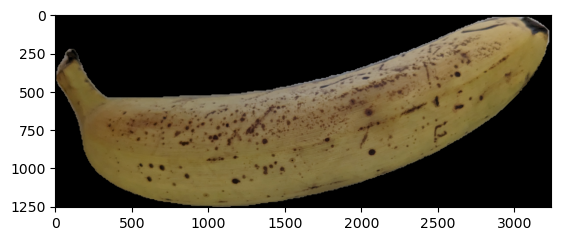

1/1 [==============================] - 0s 30ms/step
[ 5.9415e-06  3.4168e-05  4.9268e-14     0.99996]
2.999913647840102
81.48148148148148 %
file and hours Bananas time dataset/t4_48 (2).jpg 48.0



0: 480x640 1 banana, 2948.8ms
Speed: 4.0ms preprocess, 2948.8ms inference, 16.4ms postprocess per image at shape (1, 3, 640, 640)


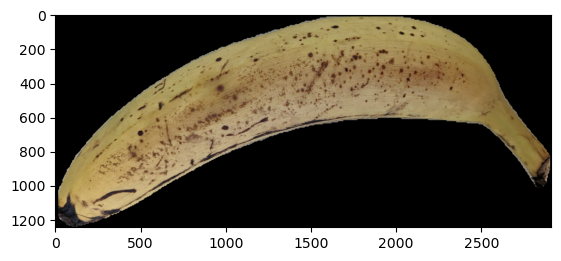

1/1 [==============================] - 0s 29ms/step
[ 4.4923e-05     0.29591  1.0991e-07     0.70405]
2.4080467336254543
85.18518518518519 %
file and hours Bananas time dataset/t4_48 (3).jpg 48.0



0: 480x640 1 knife, 1 banana, 2902.3ms
Speed: 6.5ms preprocess, 2902.3ms inference, 11.6ms postprocess per image at shape (1, 3, 640, 640)


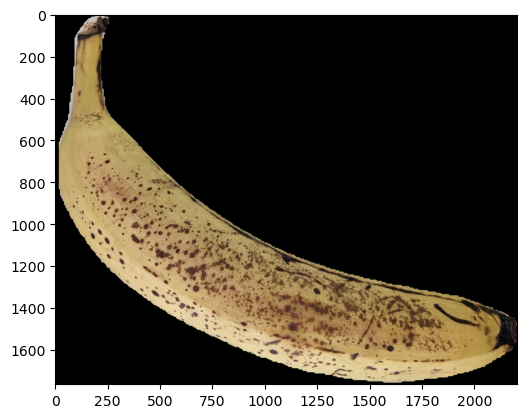

1/1 [==============================] - 0s 30ms/step
[ 0.00030576     0.89666    0.085895    0.017142]
1.1198724713176489
88.88888888888889 %
file and hours Bananas time dataset/t4_70 (2).jpg 70.0



0: 480x640 1 banana, 2958.4ms
Speed: 4.0ms preprocess, 2958.4ms inference, 33.0ms postprocess per image at shape (1, 3, 640, 640)


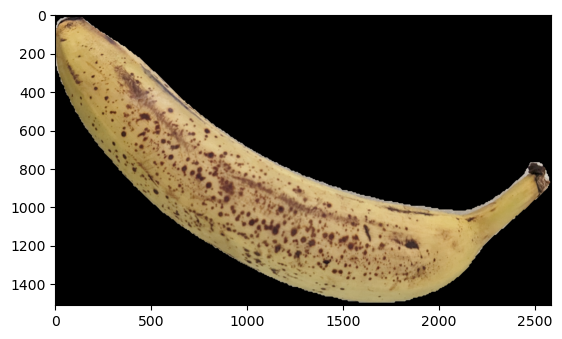

1/1 [==============================] - 0s 28ms/step
[ 2.0137e-06     0.99386  4.7429e-05   0.0060867]
1.0122187755914638
92.5925925925926 %
file and hours Bananas time dataset/t4_70 (3).jpg 70.0



0: 640x480 1 banana, 1 toilet, 2996.4ms
Speed: 5.0ms preprocess, 2996.4ms inference, 12.0ms postprocess per image at shape (1, 3, 640, 640)


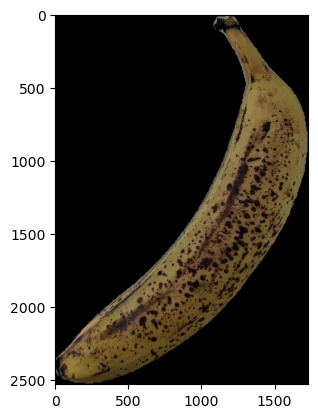

1/1 [==============================] - 0s 27ms/step
[ 2.1442e-05  0.00033639     0.99964  2.7738e-06]
1.9996234987952448
96.29629629629629 %
file and hours Bananas time dataset/t4_97 (1).jpg 97.0



0: 480x640 1 knife, 1 banana, 2989.8ms
Speed: 5.0ms preprocess, 2989.8ms inference, 13.4ms postprocess per image at shape (1, 3, 640, 640)


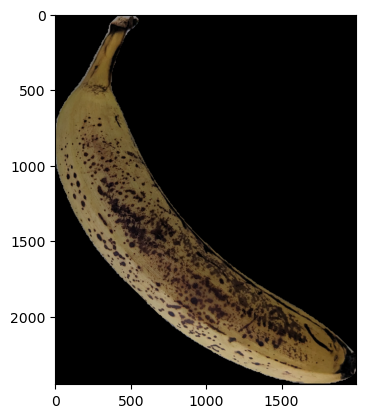

1/1 [==============================] - 0s 29ms/step
[ 1.6753e-06  9.4399e-06     0.99999  2.0962e-07]
1.9999874190507256
100.0 %
file and hours Bananas time dataset/t4_97 (3).jpg 97.0
NaNs= []
[     2.8953      2.8653      2.9566           0      1.5305      1.8142      1.9934      1.9999  8.7157e-14   0.0068371     0.22468  1.9307e-10  1.5657e-16  3.4247e-09      2.9999      2.9999      2.9968           3    4.41e-11           2      1.3706      2.9999       2.408      1.1199      1.0122      1.9996
           2] [          0           0           0           0         124         124         146         146         167         167         193         193         217         217          24          24          24          24         241         241          48          48          48          70          70          97
          97] [     2.8953      2.8653      2.9566           0      1.5305      1.8142      1.9934      1.9999  8.7157e-14   0.0068371     0.22468  1.9307e-10  1.5657e

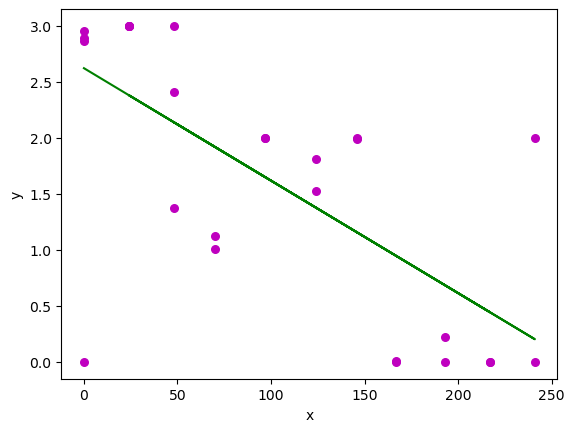

In [ ]:
xx, yy = time_analysis(files, start_index[4], end_index[4])


0: 640x480 1 banana, 3017.7ms
Speed: 5.0ms preprocess, 3017.7ms inference, 16.9ms postprocess per image at shape (1, 3, 640, 640)


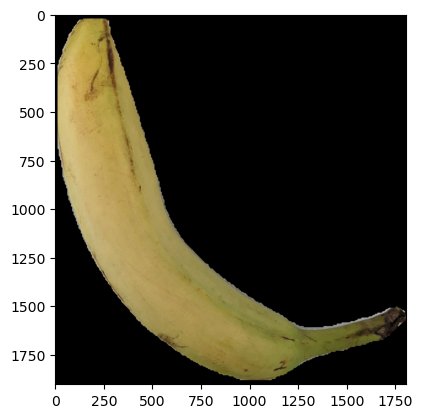

1/1 [==============================] - 0s 29ms/step
[  0.0010397    0.063378  4.1762e-06     0.93558]
2.870121702920187
3.225806451612903 %
file and hours Bananas time dataset/t5_0 (1).jpg 0.0



0: 480x640 1 bowl, 1 banana, 2980.1ms
Speed: 5.0ms preprocess, 2980.1ms inference, 12.6ms postprocess per image at shape (1, 3, 640, 640)


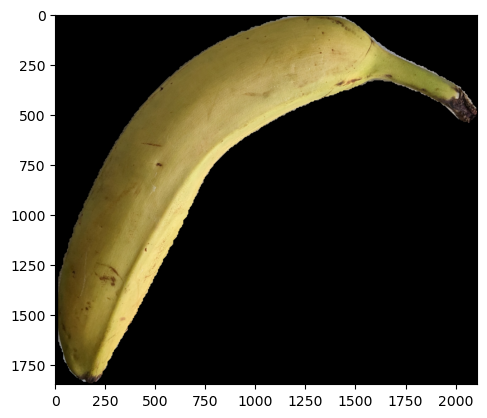

1/1 [==============================] - 0s 27ms/step
[ 0.00020324    0.057628  1.3297e-05     0.94216]
2.884120593978878
6.451612903225806 %
file and hours Bananas time dataset/t5_0 (2).jpg 0.0



0: 480x640 1 knife, 1 banana, 2930.3ms
Speed: 4.0ms preprocess, 2930.3ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


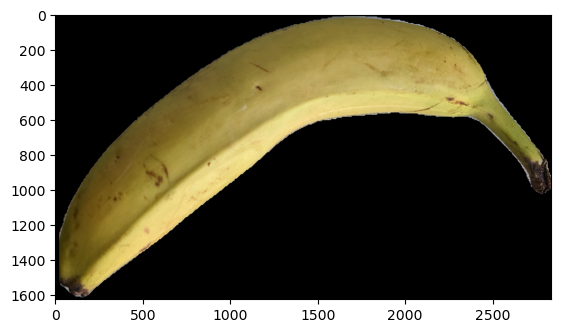

1/1 [==============================] - 0s 28ms/step
[ 2.5565e-05   0.0007619  2.3256e-10     0.99921]
2.9983994119096677
9.67741935483871 %
file and hours Bananas time dataset/t5_0 (3).jpg 0.0



0: 480x640 1 banana, 1 keyboard, 2968.2ms
Speed: 5.0ms preprocess, 2968.2ms inference, 11.0ms postprocess per image at shape (1, 3, 640, 640)


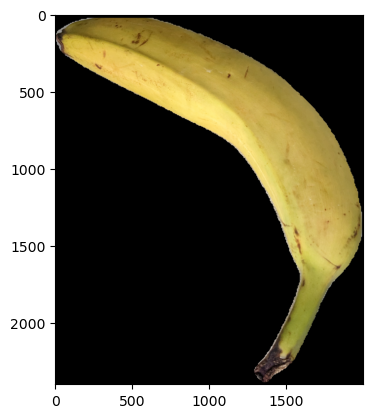

1/1 [==============================] - 0s 32ms/step
[  0.0015951     0.10605  7.3126e-06     0.89235]
2.78311286092503
12.903225806451612 %
file and hours Bananas time dataset/t5_0 (4).jpg 0.0



0: 480x640 1 knife, 1 banana, 2908.1ms
Speed: 4.0ms preprocess, 2908.1ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


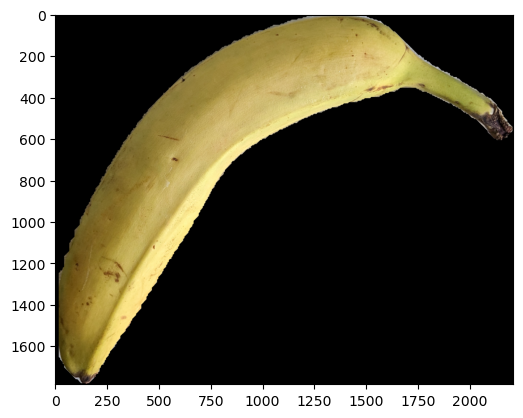

1/1 [==============================] - 0s 29ms/step
[ 0.00020719    0.022667  3.9976e-06     0.97712]
2.954039641356758
16.129032258064516 %
file and hours Bananas time dataset/t5_0 (5).jpg 0.0



0: 480x640 1 knife, 1 banana, 2980.2ms
Speed: 4.0ms preprocess, 2980.2ms inference, 19.0ms postprocess per image at shape (1, 3, 640, 640)


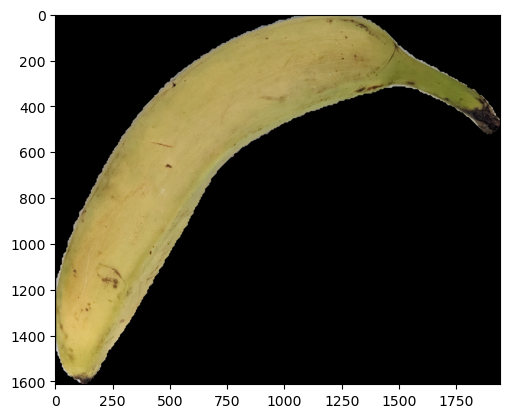

1/1 [==============================] - 0s 30ms/step
[  0.0001045    0.087049  8.1894e-06     0.91284]
2.8255791987248813
19.35483870967742 %
file and hours Bananas time dataset/t5_0 (6).jpg 0.0



0: 640x480 1 banana, 2937.9ms
Speed: 7.0ms preprocess, 2937.9ms inference, 17.0ms postprocess per image at shape (1, 3, 640, 640)


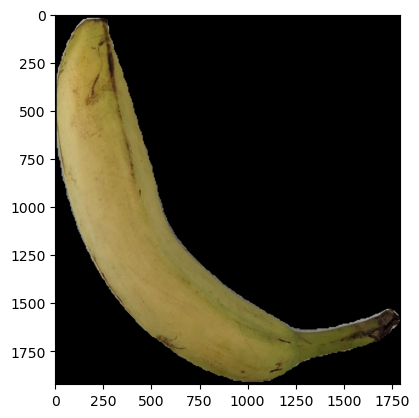

1/1 [==============================] - 0s 29ms/step
[ 0.00075983     0.10809  9.5777e-06     0.89114]
2.7815378158738895
22.58064516129032 %
file and hours Bananas time dataset/t5_0 (7).jpg 0.0



0: 640x480 1 bottle, 1 banana, 2954.2ms
Speed: 4.0ms preprocess, 2954.2ms inference, 15.5ms postprocess per image at shape (1, 3, 640, 640)


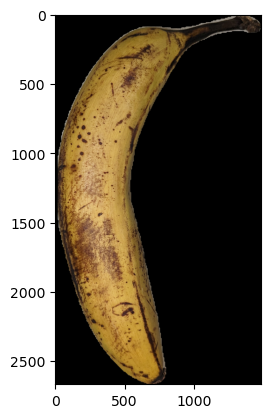

1/1 [==============================] - 0s 31ms/step
[ 2.4893e-05     0.66627  2.1494e-05     0.33368]
1.6673646095514414
25.806451612903224 %
file and hours Bananas time dataset/t5_124 (1).jpg 124.0



0: 640x480 1 banana, 3037.2ms
Speed: 5.0ms preprocess, 3037.2ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


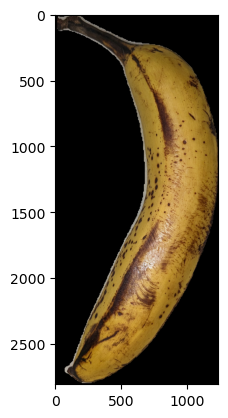

1/1 [==============================] - 0s 27ms/step
[ 1.4311e-05     0.92655  4.2221e-05    0.073395]
1.1468178684008308
29.03225806451613 %
file and hours Bananas time dataset/t5_124 (2).jpg 124.0



0: 480x640 1 kite, 1 banana, 2943.5ms
Speed: 4.0ms preprocess, 2943.5ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


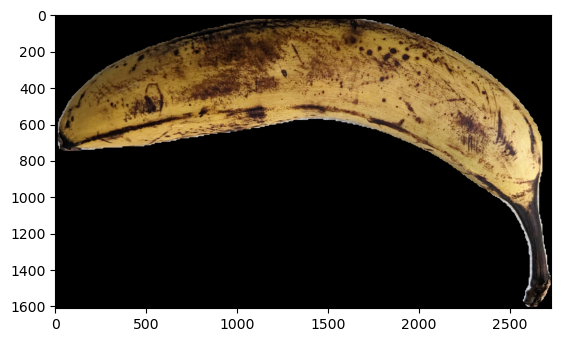

1/1 [==============================] - 0s 29ms/step
[ 1.7553e-05     0.99032   0.0044144   0.0052471]
1.0148911024443805
32.25806451612903 %
file and hours Bananas time dataset/t5_146 (1).jpg 146.0



0: 480x640 1 banana, 3018.7ms
Speed: 4.0ms preprocess, 3018.7ms inference, 33.0ms postprocess per image at shape (1, 3, 640, 640)


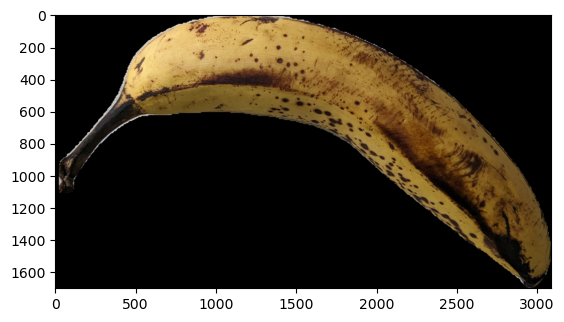

1/1 [==============================] - 0s 30ms/step
[ 2.6018e-06     0.36637     0.63361  2.1873e-05]
1.6336491655147256
35.483870967741936 %
file and hours Bananas time dataset/t5_146 (2).jpg 146.0



0: 640x480 1 banana, 2943.7ms
Speed: 4.0ms preprocess, 2943.7ms inference, 21.5ms postprocess per image at shape (1, 3, 640, 640)


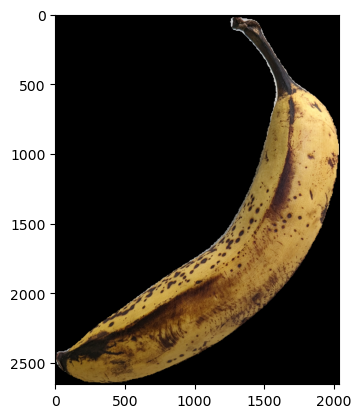

1/1 [==============================] - 0s 29ms/step
[ 6.4827e-06    0.072184     0.92702  0.00079177]
1.9285949532059021
38.70967741935484 %
file and hours Bananas time dataset/t5_167 (1).jpg 167.0



0: 480x640 1 frisbee, 1 banana, 2888.4ms
Speed: 5.4ms preprocess, 2888.4ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


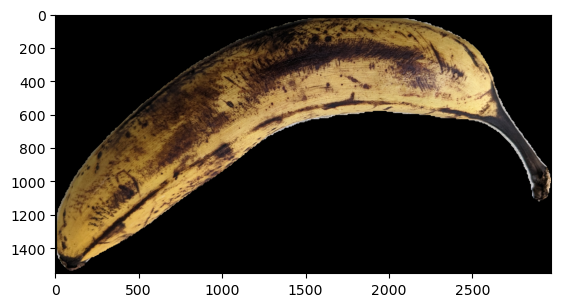

1/1 [==============================] - 0s 27ms/step
[ 5.1006e-13  3.6315e-13           1  1.2237e-12]
2.0000000000040346
41.935483870967744 %
file and hours Bananas time dataset/t5_167 (2).jpg 167.0



0: 480x640 1 kite, 1 banana, 3020.6ms
Speed: 4.0ms preprocess, 3020.6ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


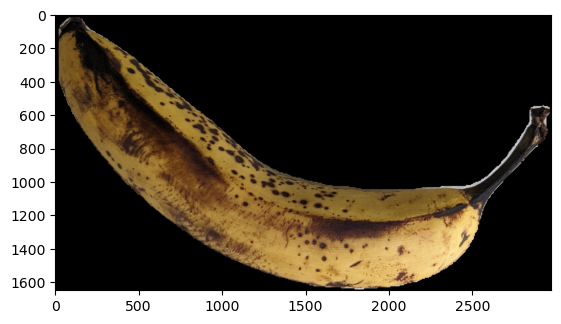

1/1 [==============================] - 0s 28ms/step
[ 3.3863e-07  2.0187e-05     0.99998  3.3204e-07]
1.9999794598095946
45.16129032258064 %
file and hours Bananas time dataset/t5_193 (1).jpg 193.0



0: 640x480 1 banana, 2909.2ms
Speed: 4.0ms preprocess, 2909.2ms inference, 18.9ms postprocess per image at shape (1, 3, 640, 640)


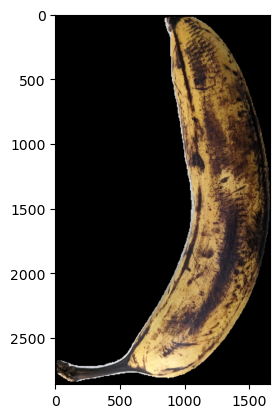

1/1 [==============================] - 0s 30ms/step
[ 5.2517e-06  6.8594e-12     0.99999  3.8946e-12]
1.9999895096010627
48.38709677419355 %
file and hours Bananas time dataset/t5_193 (2).jpg 193.0



0: 480x640 1 tie, 1 banana, 2933.8ms
Speed: 5.0ms preprocess, 2933.8ms inference, 11.0ms postprocess per image at shape (1, 3, 640, 640)


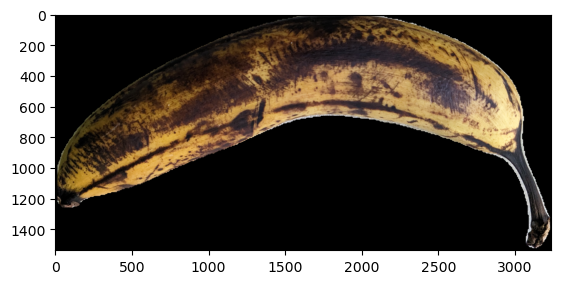

1/1 [==============================] - 0s 29ms/step
[ 4.2096e-15  2.1806e-22           1   4.769e-17]
2.0
51.61290322580645 %
file and hours Bananas time dataset/t5_217 (1).jpg 217.0



0: 640x480 1 banana, 2898.1ms
Speed: 4.0ms preprocess, 2898.1ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


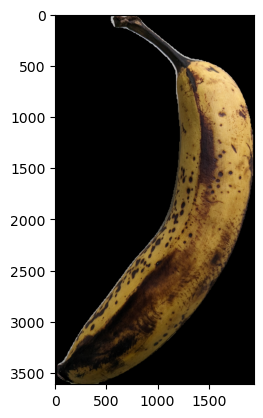

1/1 [==============================] - 0s 29ms/step
[ 1.6043e-12  1.3184e-06           1  1.6909e-17]
1.999998695769591
54.83870967741935 %
file and hours Bananas time dataset/t5_217 (2).jpg 217.0



0: 480x640 1 banana, 2888.0ms
Speed: 5.0ms preprocess, 2888.0ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


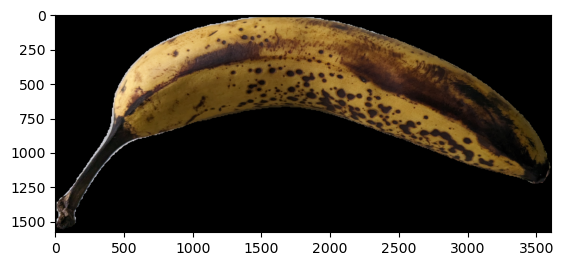

1/1 [==============================] - 0s 28ms/step
[ 1.6886e-06  0.00034382     0.99965  3.9662e-07]
1.9996533557042824
58.06451612903226 %
file and hours Bananas time dataset/t5_217 (3).jpg 217.0



0: 480x640 1 banana, 1 hot dog, 2986.1ms
Speed: 4.0ms preprocess, 2986.1ms inference, 17.0ms postprocess per image at shape (1, 3, 640, 640)


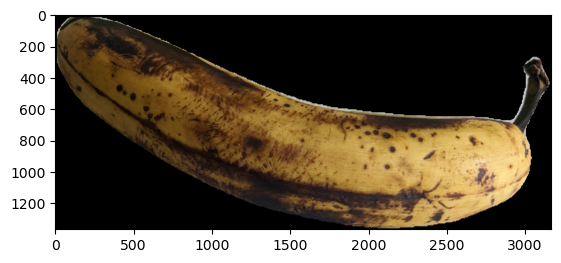

1/1 [==============================] - 0s 30ms/step
[ 0.00076682     0.91565  0.00042139    0.083157]
1.165969075052999
61.29032258064516 %
file and hours Bananas time dataset/t5_217 (4).jpg 217.0



0: 640x480 1 banana, 2919.3ms
Speed: 4.0ms preprocess, 2919.3ms inference, 23.0ms postprocess per image at shape (1, 3, 640, 640)


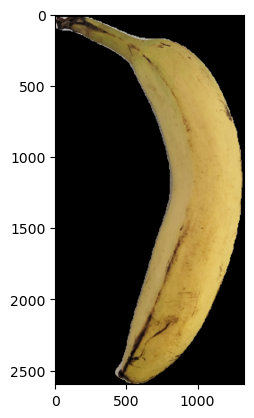

1/1 [==============================] - 0s 30ms/step
[ 0.00011955     0.02119  4.2413e-10     0.97869]
2.957261885433292
64.51612903225806 %
file and hours Bananas time dataset/t5_24 (1).jpg 24.0



0: 640x480 1 banana, 3424.0ms
Speed: 4.0ms preprocess, 3424.0ms inference, 16.8ms postprocess per image at shape (1, 3, 640, 640)


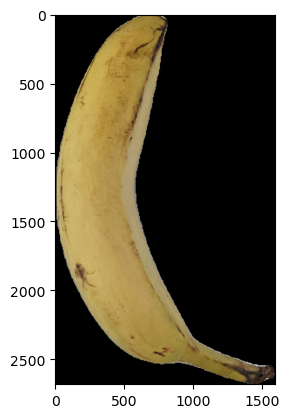

1/1 [==============================] - 0s 29ms/step
[  2.323e-07   0.0028947  3.2713e-09     0.99711]
2.994209846737804
67.74193548387096 %
file and hours Bananas time dataset/t5_24 (2).jpg 24.0



0: 640x480 1 banana, 3044.0ms
Speed: 3.1ms preprocess, 3044.0ms inference, 17.1ms postprocess per image at shape (1, 3, 640, 640)


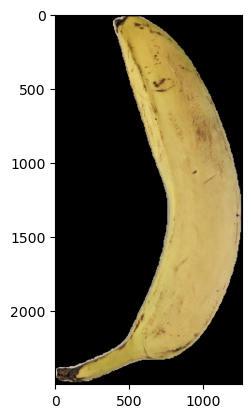

1/1 [==============================] - 0s 28ms/step
[  0.0027562  0.00052387  5.4815e-11     0.99672]
2.9906835627557853
70.96774193548387 %
file and hours Bananas time dataset/t5_24 (3).jpg 24.0



0: 480x640 1 banana, 2854.5ms
Speed: 5.0ms preprocess, 2854.5ms inference, 19.0ms postprocess per image at shape (1, 3, 640, 640)


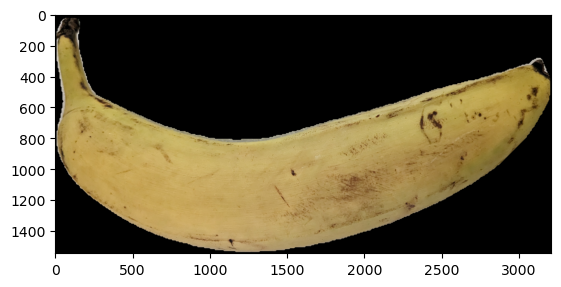

1/1 [==============================] - 0s 27ms/step
[ 3.3177e-06  0.00032572  6.4195e-15     0.99967]
2.999338667432325
74.19354838709677 %
file and hours Bananas time dataset/t5_24 (4).jpg 24.0



0: 480x640 1 banana, 2981.1ms
Speed: 6.0ms preprocess, 2981.1ms inference, 20.0ms postprocess per image at shape (1, 3, 640, 640)


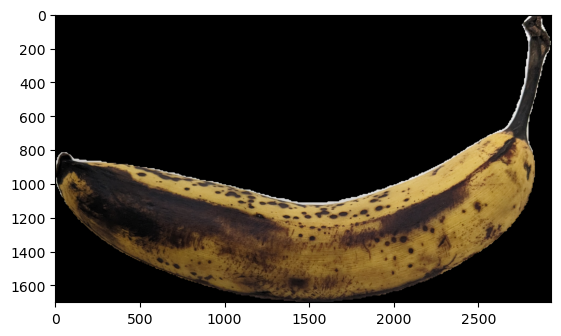

1/1 [==============================] - 0s 29ms/step
[ 7.7777e-22           0           1           0]
2.0
77.41935483870968 %
file and hours Bananas time dataset/t5_240 (1).jpg 240.0



0: 640x480 1 kite, 1 surfboard, 3033.2ms
Speed: 4.0ms preprocess, 3033.2ms inference, 12.0ms postprocess per image at shape (1, 3, 640, 640)


no banana found
80.64516129032258 %
file and hours Bananas time dataset/t5_240 (2).jpg 240.0



0: 480x640 1 knife, 1 banana, 2938.5ms
Speed: 4.0ms preprocess, 2938.5ms inference, 10.3ms postprocess per image at shape (1, 3, 640, 640)


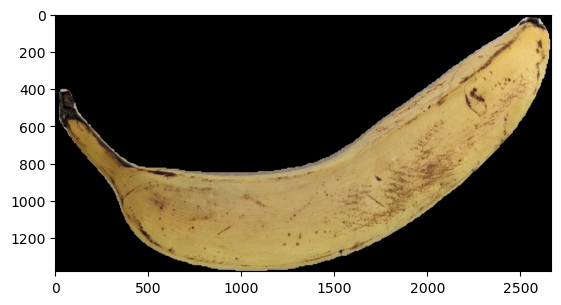

1/1 [==============================] - 0s 29ms/step
[ 0.00025124     0.28685  4.1051e-08      0.7129]
2.425552807894178
83.87096774193549 %
file and hours Bananas time dataset/t5_48 (3).jpg 48.0



0: 480x640 1 kite, 1 banana, 3067.9ms
Speed: 3.0ms preprocess, 3067.9ms inference, 11.0ms postprocess per image at shape (1, 3, 640, 640)


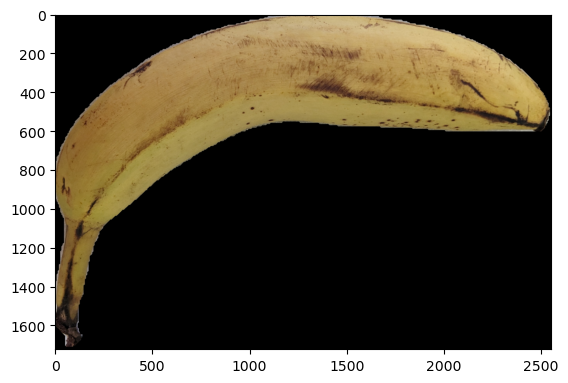

1/1 [==============================] - 0s 29ms/step
[  6.971e-05     0.61471  3.6398e-05     0.38519]
1.770339388269349
87.09677419354838 %
file and hours Bananas time dataset/t5_48 (4).jpg 48.0



0: 640x480 1 surfboard, 1 banana, 3046.0ms
Speed: 4.0ms preprocess, 3046.0ms inference, 12.7ms postprocess per image at shape (1, 3, 640, 640)


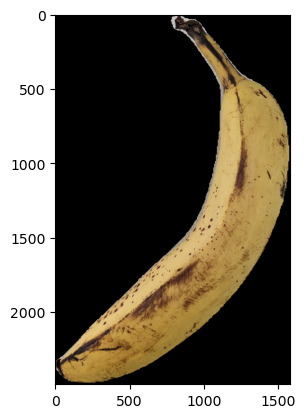

1/1 [==============================] - 0s 29ms/step
[ 0.00010946     0.89354   0.0024039     0.10394]
1.2101839543320239
90.32258064516128 %
file and hours Bananas time dataset/t5_70 (1).jpg 70.0



0: 480x640 1 banana, 3077.4ms
Speed: 4.1ms preprocess, 3077.4ms inference, 18.0ms postprocess per image at shape (1, 3, 640, 640)


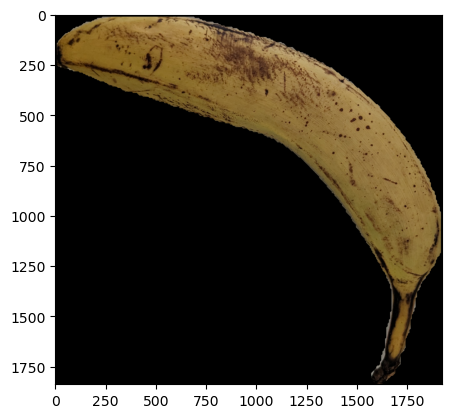

1/1 [==============================] - 0s 28ms/step
[ 1.5504e-05     0.99675   0.0016186   0.0016192]
1.0048416043864563
93.54838709677419 %
file and hours Bananas time dataset/t5_70 (3).jpg 70.0



0: 480x640 1 surfboard, 1 banana, 3073.2ms
Speed: 5.0ms preprocess, 3073.2ms inference, 11.0ms postprocess per image at shape (1, 3, 640, 640)


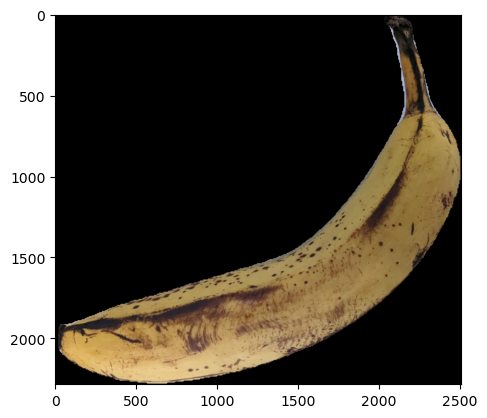

1/1 [==============================] - 0s 28ms/step
[  0.0062925     0.65599     0.16827     0.16944]
1.5008685141801834
96.7741935483871 %
file and hours Bananas time dataset/t5_97 (2).jpg 97.0



0: 480x640 1 knife, 1 banana, 3063.2ms
Speed: 5.0ms preprocess, 3063.2ms inference, 9.0ms postprocess per image at shape (1, 3, 640, 640)


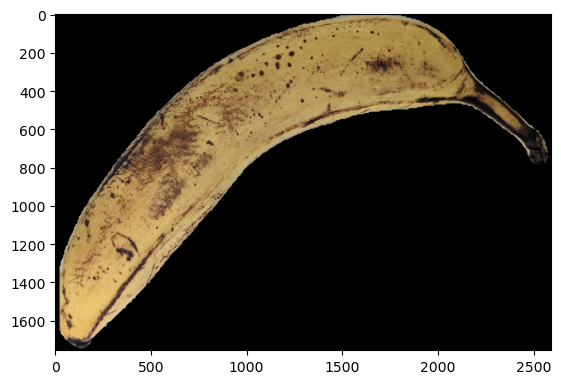

1/1 [==============================] - 0s 28ms/step
[ 5.0454e-07     0.99775   0.0020113  0.00023665]
1.0024840291589499
100.0 %
file and hours Bananas time dataset/t5_97 (3).jpg 97.0
NaNs= []
[     2.8701      2.8841      2.9984      2.7831       2.954      2.8256      2.7815      1.6674      1.1468      1.0149      1.6336      1.9286           2           2           2           2           2      1.9997       1.166      2.9573      2.9942      2.9907      2.9993           2           0      2.4256
      1.7703      1.2102      1.0048      1.5009      1.0025] [          0           0           0           0           0           0           0         124         124         146         146         167         167         193         193         217         217         217         217          24          24          24          24         240         240          48
          48          70          70          97          97] [     2.8701      2.8841      2.9984      2.7831       2.

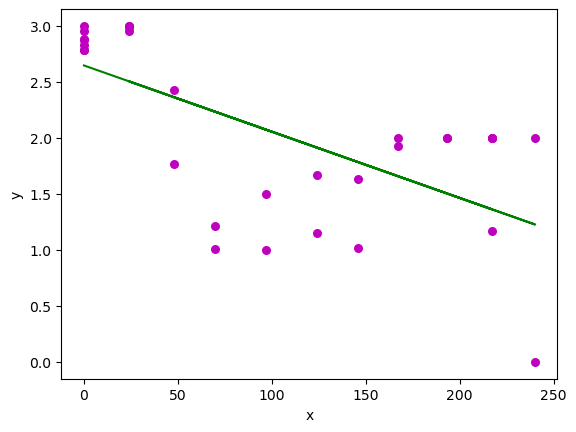

In [ ]:
xx, yy = time_analysis(files, start_index[5], end_index[5])


0: 480x640 2 suitcases, 1 knife, 1 banana, 2918.9ms
Speed: 4.0ms preprocess, 2918.9ms inference, 13.6ms postprocess per image at shape (1, 3, 640, 640)


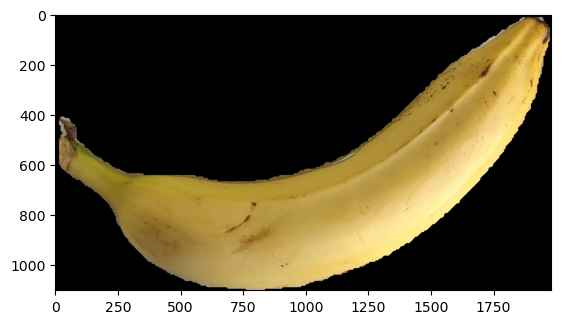

1/1 [==============================] - 0s 31ms/step
[  2.899e-05    0.010967  2.6847e-10       0.989]
2.977979569301511
3.225806451612903 %
file and hours Bananas time dataset/t6_0 (2).jpg 0.0



0: 640x480 1 person, 1 banana, 2977.8ms
Speed: 8.2ms preprocess, 2977.8ms inference, 12.0ms postprocess per image at shape (1, 3, 640, 640)


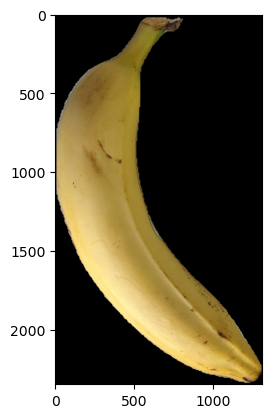

1/1 [==============================] - 0s 31ms/step
[  2.361e-06    0.012877   1.785e-10     0.98712]
2.9742380672910453
6.451612903225806 %
file and hours Bananas time dataset/t6_0 (3).jpg 0.0



0: 640x480 1 banana, 1 sink, 2983.4ms
Speed: 5.0ms preprocess, 2983.4ms inference, 15.0ms postprocess per image at shape (1, 3, 640, 640)


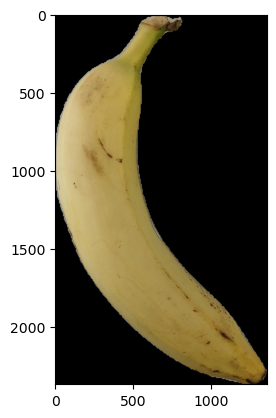

1/1 [==============================] - 0s 29ms/step
[ 2.0617e-07  0.00024231  5.0973e-14     0.99976]
2.9995147125883816
9.67741935483871 %
file and hours Bananas time dataset/t6_0 (5).jpg 0.0



0: 640x480 1 spoon, 1 banana, 3053.9ms
Speed: 5.0ms preprocess, 3053.9ms inference, 18.5ms postprocess per image at shape (1, 3, 640, 640)


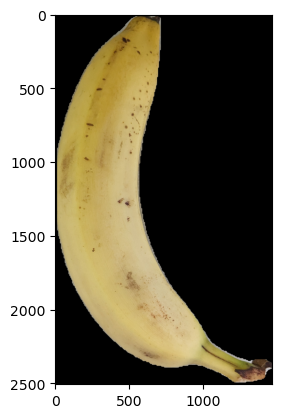

1/1 [==============================] - 0s 30ms/step
[   0.073523   0.0008248   6.786e-08     0.92565]
2.777782622530495
12.903225806451612 %
file and hours Bananas time dataset/t6_0 (6).jpg 0.0



0: 640x480 1 banana, 2938.2ms
Speed: 5.1ms preprocess, 2938.2ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


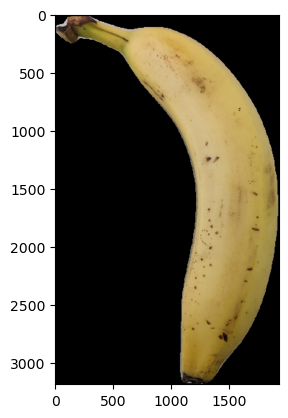

1/1 [==============================] - 0s 31ms/step
[   0.025617    0.016123  2.2811e-05     0.95824]
2.8908787701329857
16.129032258064516 %
file and hours Bananas time dataset/t6_0 (7).jpg 0.0



0: 480x640 1 banana, 3011.2ms
Speed: 4.0ms preprocess, 3011.2ms inference, 15.0ms postprocess per image at shape (1, 3, 640, 640)


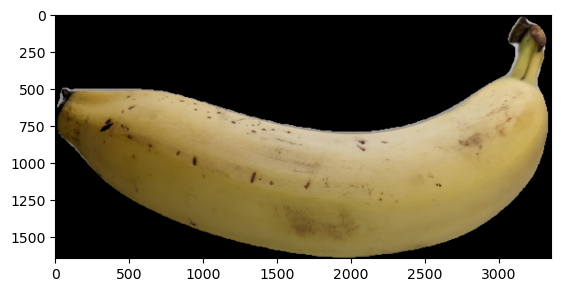

1/1 [==============================] - 0s 31ms/step
[    0.18357  0.00035308  4.3071e-10     0.81608]
2.4485935388830793
19.35483870967742 %
file and hours Bananas time dataset/t6_0 (8).jpg 0.0



0: 480x640 1 banana, 2960.5ms
Speed: 6.0ms preprocess, 2960.5ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


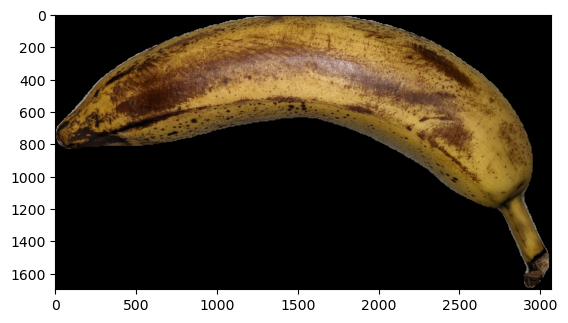

1/1 [==============================] - 0s 28ms/step
[ 1.7518e-06     0.99925   0.0004305  0.00031284]
1.0010544185643084
22.58064516129032 %
file and hours Bananas time dataset/t6_124 (2).jpg 124.0



0: 640x480 1 kite, 1 banana, 2976.5ms
Speed: 21.0ms preprocess, 2976.5ms inference, 17.0ms postprocess per image at shape (1, 3, 640, 640)


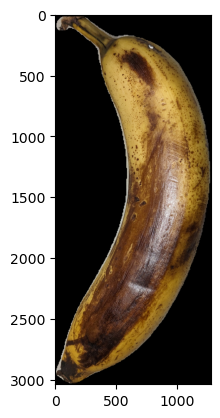

1/1 [==============================] - 0s 28ms/step
[ 4.5563e-11  2.4769e-14           1  4.4051e-16]
2.000000000000026
25.806451612903224 %
file and hours Bananas time dataset/t6_124 (3).jpg 124.0



0: 640x480 1 banana, 2925.8ms
Speed: 4.0ms preprocess, 2925.8ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


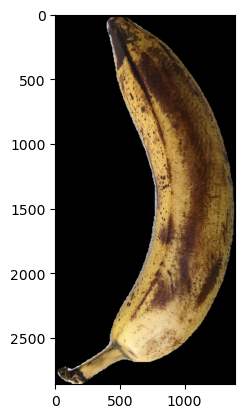

1/1 [==============================] - 0s 29ms/step
[ 2.6513e-05     0.99481   0.0034701   0.0016891]
1.0068219350650907
29.03225806451613 %
file and hours Bananas time dataset/t6_146 (1).jpg 146.0



0: 480x640 1 banana, 2869.1ms
Speed: 6.0ms preprocess, 2869.1ms inference, 18.0ms postprocess per image at shape (1, 3, 640, 640)


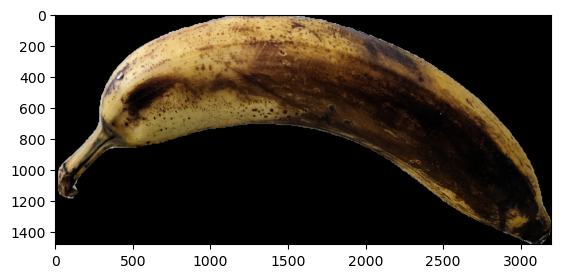

1/1 [==============================] - 0s 29ms/step
[ 5.0684e-07    0.051109     0.94886  3.4795e-05]
1.948924510696088
32.25806451612903 %
file and hours Bananas time dataset/t6_146 (2).jpg 146.0



0: 640x480 1 kite, 1 banana, 2974.0ms
Speed: 7.0ms preprocess, 2974.0ms inference, 14.6ms postprocess per image at shape (1, 3, 640, 640)


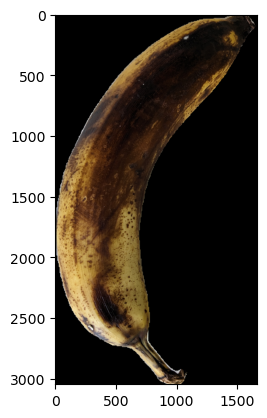

1/1 [==============================] - 0s 30ms/step
[ 9.5984e-07    0.012905     0.98707  2.0076e-05]
1.9871136288838898
35.483870967741936 %
file and hours Bananas time dataset/t6_167 (1).jpg 167.0



0: 640x480 1 banana, 2879.7ms
Speed: 5.0ms preprocess, 2879.7ms inference, 27.0ms postprocess per image at shape (1, 3, 640, 640)


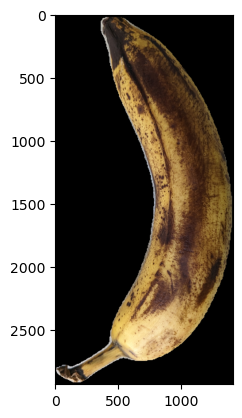

1/1 [==============================] - 0s 28ms/step
[ 0.00054063     0.90656    0.091064    0.001835]
1.094193738535978
38.70967741935484 %
file and hours Bananas time dataset/t6_167 (2).jpg 167.0



0: 640x480 1 knife, 1 banana, 2906.4ms
Speed: 4.0ms preprocess, 2906.4ms inference, 12.9ms postprocess per image at shape (1, 3, 640, 640)


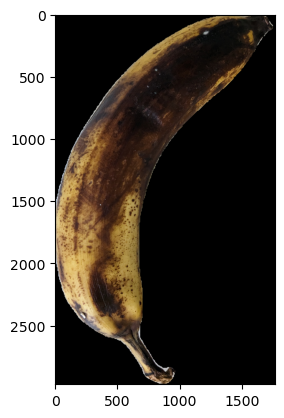

1/1 [==============================] - 0s 31ms/step
[ 5.1906e-10   0.0027341     0.99721  5.8158e-05]
1.9973239733153605
41.935483870967744 %
file and hours Bananas time dataset/t6_193 (1).jpg 193.0



0: 640x480 1 snowboard, 1 kite, 1 banana, 2863.2ms
Speed: 5.7ms preprocess, 2863.2ms inference, 19.1ms postprocess per image at shape (1, 3, 640, 640)


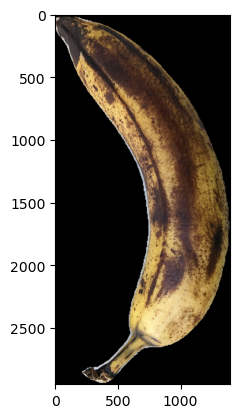

1/1 [==============================] - 0s 31ms/step
[ 1.9145e-14  1.4235e-22           1  1.5119e-22]
2.0
45.16129032258064 %
file and hours Bananas time dataset/t6_193 (2).jpg 193.0



0: 480x640 1 kite, 1 banana, 2824.5ms
Speed: 6.0ms preprocess, 2824.5ms inference, 11.0ms postprocess per image at shape (1, 3, 640, 640)


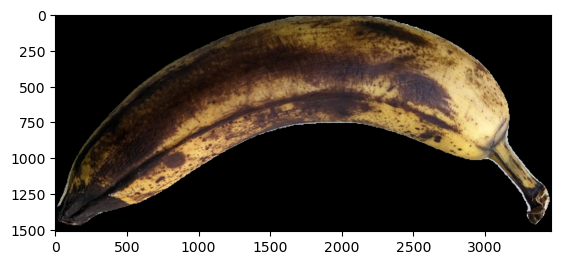

1/1 [==============================] - 0s 31ms/step
[ 5.0776e-13     0.97311    0.026893  1.0014e-19]
1.0268930569291115
48.38709677419355 %
file and hours Bananas time dataset/t6_217 (1).jpg 217.0



0: 480x640 1 kite, 1 banana, 2933.2ms
Speed: 5.0ms preprocess, 2933.2ms inference, 18.0ms postprocess per image at shape (1, 3, 640, 640)


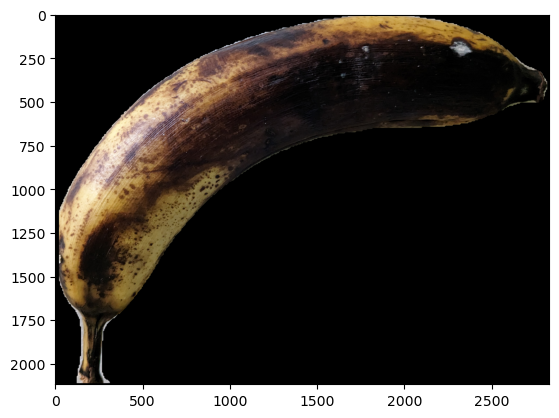

1/1 [==============================] - 0s 28ms/step
[ 5.2985e-07  9.2093e-09     0.99999  7.7822e-06]
2.000006904907141
51.61290322580645 %
file and hours Bananas time dataset/t6_217 (2).jpg 217.0



0: 480x640 1 kite, 1 knife, 1 banana, 2899.4ms
Speed: 6.0ms preprocess, 2899.4ms inference, 19.0ms postprocess per image at shape (1, 3, 640, 640)


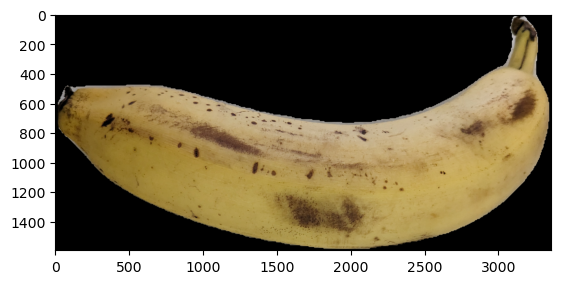

1/1 [==============================] - 0s 31ms/step
[ 9.9399e-06  0.00051583    7.88e-13     0.99947]
2.9989388745177465
54.83870967741935 %
file and hours Bananas time dataset/t6_24 (1).jpg 24.0



0: 480x640 1 knife, 1 banana, 2999.3ms
Speed: 5.0ms preprocess, 2999.3ms inference, 19.2ms postprocess per image at shape (1, 3, 640, 640)


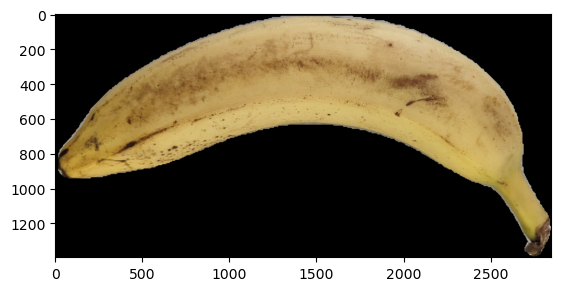

1/1 [==============================] - 0s 29ms/step
[ 1.6392e-06    0.099288  1.7602e-11     0.90071]
2.8014184683913355
58.06451612903226 %
file and hours Bananas time dataset/t6_24 (3).jpg 24.0



0: 640x480 1 banana, 2934.5ms
Speed: 4.0ms preprocess, 2934.5ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


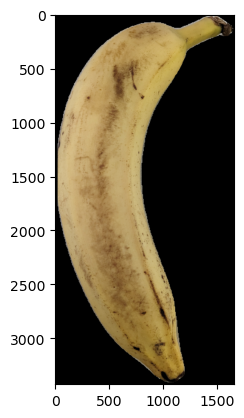

1/1 [==============================] - 0s 26ms/step
[ 3.4704e-07   0.0031205  9.2918e-12     0.99688]
2.9937581140733824
61.29032258064516 %
file and hours Bananas time dataset/t6_24 (4).jpg 24.0



0: 640x480 1 banana, 2888.4ms
Speed: 7.0ms preprocess, 2888.4ms inference, 18.0ms postprocess per image at shape (1, 3, 640, 640)


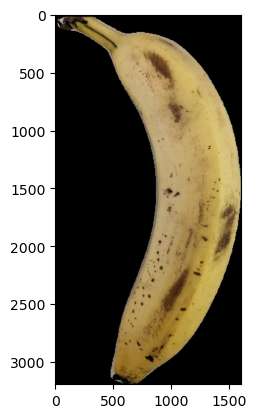

1/1 [==============================] - 0s 27ms/step
[ 0.00037856   0.0029358  1.1253e-10     0.99669]
2.9929928150881553
64.51612903225806 %
file and hours Bananas time dataset/t6_24 (5).jpg 24.0



0: 640x480 1 banana, 3014.6ms
Speed: 4.0ms preprocess, 3014.6ms inference, 15.0ms postprocess per image at shape (1, 3, 640, 640)


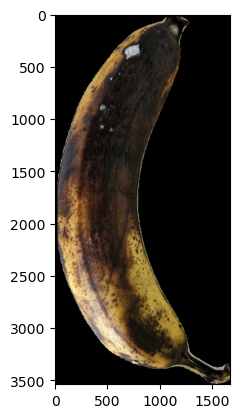

1/1 [==============================] - 0s 27ms/step
[ 3.8476e-12  1.8201e-11           1  2.2043e-14]
2.000000000018267
67.74193548387096 %
file and hours Bananas time dataset/t6_241 (1).jpg 241.0



0: 640x480 1 banana, 3012.8ms
Speed: 5.0ms preprocess, 3012.8ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


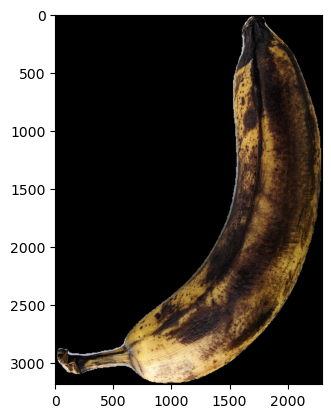

1/1 [==============================] - 0s 30ms/step
[ 2.9516e-15  5.1685e-13           1  5.3456e-15]
2.000000000000533
70.96774193548387 %
file and hours Bananas time dataset/t6_241 (2).jpg 241.0



0: 640x480 1 person, 1 spoon, 1 banana, 3048.5ms
Speed: 6.0ms preprocess, 3048.5ms inference, 19.7ms postprocess per image at shape (1, 3, 640, 640)


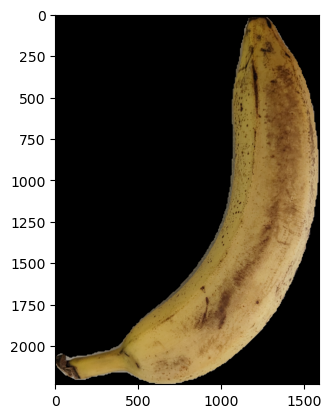

1/1 [==============================] - 0s 31ms/step
[ 0.00023954     0.49119  8.8484e-05     0.50848]
2.0168111947132275
74.19354838709677 %
file and hours Bananas time dataset/t6_48 (2).jpg 48.0



0: 640x480 1 knife, 1 banana, 2948.8ms
Speed: 5.0ms preprocess, 2948.8ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


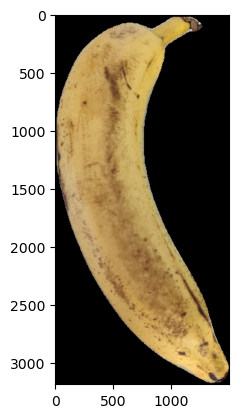

1/1 [==============================] - 0s 28ms/step
[ 4.5487e-07    0.001885  1.5253e-13     0.99811]
2.99622876674433
77.41935483870968 %
file and hours Bananas time dataset/t6_48 (3).jpg 48.0



0: 640x480 1 knife, 1 banana, 3044.1ms
Speed: 5.0ms preprocess, 3044.1ms inference, 11.0ms postprocess per image at shape (1, 3, 640, 640)


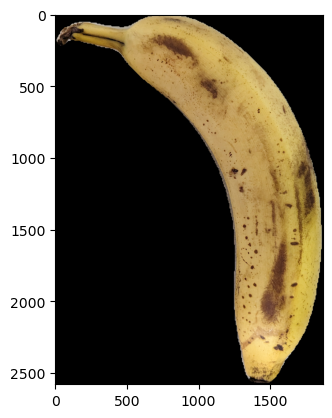

1/1 [==============================] - 0s 29ms/step
[ 2.1112e-05     0.89755  8.9324e-05     0.10234]
1.2047462290647672
80.64516129032258 %
file and hours Bananas time dataset/t6_48 (4).jpg 48.0



0: 480x640 1 airplane, 1 banana, 2906.2ms
Speed: 6.0ms preprocess, 2906.2ms inference, 12.0ms postprocess per image at shape (1, 3, 640, 640)


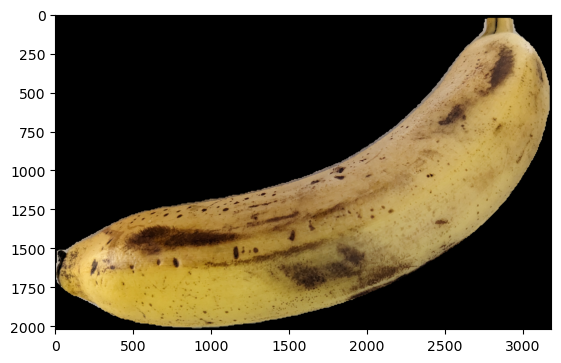

1/1 [==============================] - 0s 28ms/step
[ 8.0028e-05     0.46847  7.2919e-08     0.53145]
2.062816139863159
83.87096774193549 %
file and hours Bananas time dataset/t6_48 (5).jpg 48.0



0: 480x640 1 knife, 1 banana, 3068.7ms
Speed: 4.0ms preprocess, 3068.7ms inference, 13.9ms postprocess per image at shape (1, 3, 640, 640)


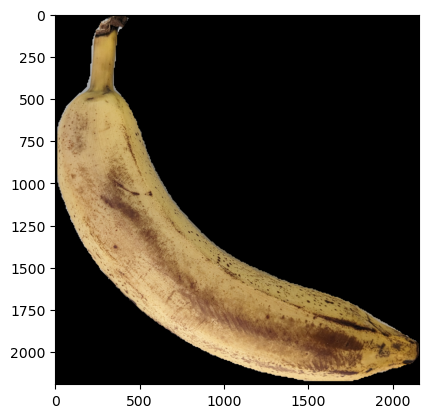

1/1 [==============================] - 0s 30ms/step
[ 9.7347e-05     0.96778   0.0009098    0.031211]
1.0632341406308115
87.09677419354838 %
file and hours Bananas time dataset/t6_70 (3).jpg 70.0



0: 640x480 1 snowboard, 1 banana, 3025.0ms
Speed: 6.4ms preprocess, 3025.0ms inference, 19.0ms postprocess per image at shape (1, 3, 640, 640)


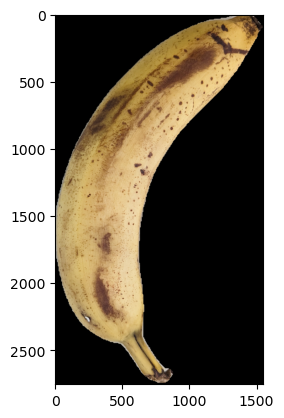

1/1 [==============================] - 0s 28ms/step
[ 0.00022671     0.71347  1.0002e-05     0.28629]
1.572362549142781
90.32258064516128 %
file and hours Bananas time dataset/t6_70 (4).jpg 70.0



0: 480x640 1 knife, 1 banana, 3046.1ms
Speed: 5.0ms preprocess, 3046.1ms inference, 16.0ms postprocess per image at shape (1, 3, 640, 640)


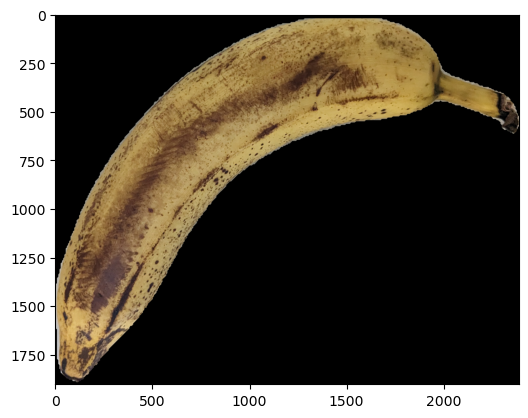

1/1 [==============================] - 0s 29ms/step
[  3.293e-06     0.99327   0.0064599  0.00026679]
1.0069902393734083
93.54838709677419 %
file and hours Bananas time dataset/t6_97 (2).jpg 97.0



0: 640x480 1 snowboard, 1 banana, 3033.7ms
Speed: 4.0ms preprocess, 3033.7ms inference, 10.0ms postprocess per image at shape (1, 3, 640, 640)


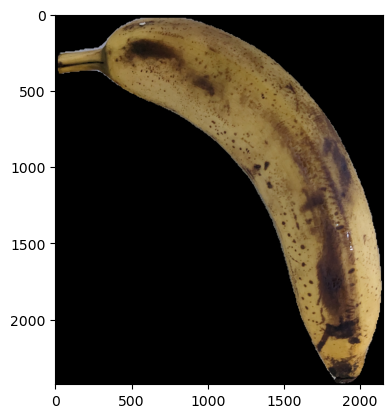

1/1 [==============================] - 0s 28ms/step
[ 7.1958e-05     0.35084    0.017988      0.6311]
2.280116032809019
96.7741935483871 %
file and hours Bananas time dataset/t6_97 (3).jpg 97.0



0: 480x640 1 knife, 1 banana, 3026.6ms
Speed: 4.0ms preprocess, 3026.6ms inference, 14.6ms postprocess per image at shape (1, 3, 640, 640)


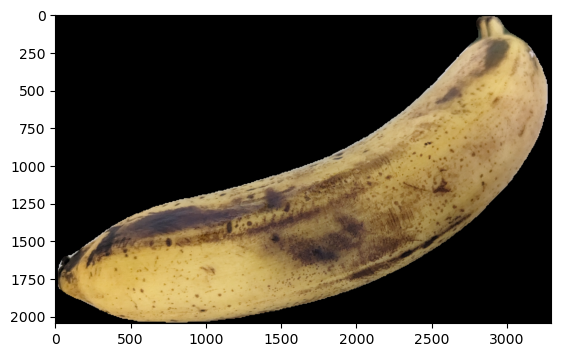

1/1 [==============================] - 0s 27ms/step
[ 1.3053e-06  4.0102e-12           1  1.8023e-16]
1.9999973773996405
100.0 %
file and hours Bananas time dataset/t6_97 (4).jpg 97.0
NaNs= []
[      2.978      2.9742      2.9995      2.7778      2.8909      2.4486      1.0011           2      1.0068      1.9489      1.9871      1.0942      1.9973           2      1.0269           2      2.9989      2.8014      2.9938       2.993           2           2      2.0168      2.9962      1.2047      2.0628
      1.0632      1.5724       1.007      2.2801           2] [          0           0           0           0           0           0         124         124         146         146         167         167         193         193         217         217          24          24          24          24         241         241          48          48          48          48
          70          70          97          97          97] [      2.978      2.9742      2.9995      2.7778      2.8

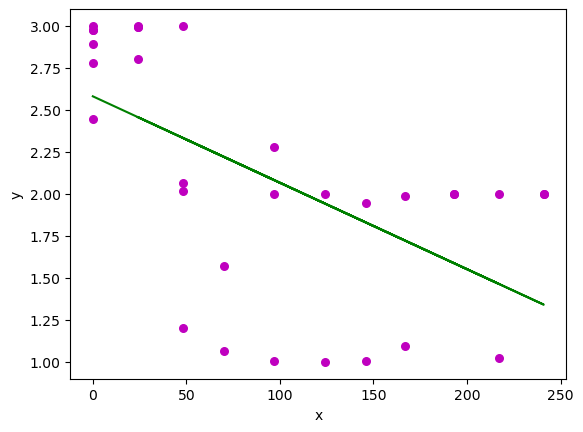

In [ ]:
time_analysis(files, start_index[6], end_index[6])